# mcortex_all_otsu_notdownsampled - own consensuspeaks

TSS: 5 as threshold, unique fragments using otsu

Saturation: 20kRPC - 131krPC
|| v2_05/10_1 only 10kRPC

In [1]:
import pycisTopic
import os
import pickle
pycisTopic.__version__

'1.0.1.dev21+g8aa75d8.d20230504'

In [2]:
from pycisTopic.clust_vis import (
    find_clusters,
    run_umap,
    run_tsne,
    plot_metadata,
    plot_topic,
    cell_topic_heatmap
)

/opt/venv/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/opt/venv/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/opt/venv/lib/python3.8/site-packages/umap/distances.py:1086: NumbaDeprecationWarning: The 'nopython' keyword argument was

In [3]:
out_dir = "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/"
#os.makedirs(out_dir, exist_ok = True)

# Walk through of preprocessing

The fastq files are preprocessed with PUMATAC (https://github.com/aertslab/PUMATAC_tutorial), fragment files are generated and 5_qc_diagnosis.ippynb is run with a TSS cut off of 5. For the Unique fragments count the otsu shreshold is used.

The seperate cistopic objects generated per sample by PUMATAC are merged and further processed (scrublet and annotated) as below: 

In [ ]:
directory = '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/cistopic_objs'

# List all .pkl files in the directory
pkl_files = [f for f in os.listdir(directory) if f.endswith('cto.pkl')]

# Load all .pkl files using pickle
cistopic_obj_list = []
for filename in pkl_files:
    filepath = os.path.join(directory, filename)
    with open(filepath, 'rb') as file:
        cistopic_obj = pickle.load(file)
        cistopic_obj_list.append(cistopic_obj)


In [6]:
from pycisTopic.cistopic_class import *

In [7]:
cistopic_obj = merge(cistopic_obj_list)

2024-07-16 09:12:21,817 cisTopic     INFO     cisTopic object 1 merged
2024-07-16 09:12:31,599 cisTopic     INFO     cisTopic object 2 merged
2024-07-16 09:12:42,278 cisTopic     INFO     cisTopic object 3 merged
2024-07-16 09:12:54,509 cisTopic     INFO     cisTopic object 4 merged
2024-07-16 09:13:06,422 cisTopic     INFO     cisTopic object 5 merged
2024-07-16 09:13:18,666 cisTopic     INFO     cisTopic object 6 merged
2024-07-16 09:13:32,392 cisTopic     INFO     cisTopic object 7 merged
2024-07-16 09:13:45,390 cisTopic     INFO     cisTopic object 8 merged
2024-07-16 09:13:59,269 cisTopic     INFO     cisTopic object 9 merged
2024-07-16 09:14:15,035 cisTopic     INFO     cisTopic object 10 merged
2024-07-16 09:14:32,327 cisTopic     INFO     cisTopic object 11 merged
2024-07-16 09:14:50,377 cisTopic     INFO     cisTopic object 12 merged
2024-07-16 09:15:08,569 cisTopic     INFO     cisTopic object 13 merged
2024-07-16 09:15:27,367 cisTopic     INFO     cisTopic object 14 merged
2

In [8]:
print(cistopic_obj)

CistopicObject from project cisTopic_merge with n_cells × n_regions = 177134 × 1086695


In [9]:
cistopic_obj.cell_data

,cisTopic_log_nr_acc,cisTopic_nr_acc,cisTopic_nr_frag,cisTopic_log_nr_frag,Log_total_nr_frag,Log_unique_nr_frag,Total_nr_frag,Unique_nr_frag,Dupl_nr_frag,Dupl_rate,Total_nr_frag_in_regions,Unique_nr_frag_in_regions,FRIP,TSS_enrichment,sample_id,kde__log_Unique_nr_frag_in_regions__TSS_enrichment,kde__log_Unique_nr_frag_in_regions__FRIP,kde__log_Unique_nr_frag_in_regions__Dupl_rate,barcode
TATAGTCACCCTGATATTCAACCACTATCG___HYA__76b206__20240430_Mouse_Cortex-a-ATAC,4.283912,19227,20459,4.310884,4.687172,4.538549,48660,34558,14102,0.289807,18346,13060,0.377915,8.940662,HYA__76b206__20240430_Mouse_Cortex-a-ATAC,0.001202,0.059122,0.037427,TATAGTCACCCTGATATTCAACCACTATCG
CTTATCAGGAAGTCCACCGTTTCTACACTT___HYA__76b206__20240430_Mouse_Cortex-a-ATAC,4.192679,15584,15852,4.200084,4.597596,4.571033,39591,37242,2349,0.059332,11069,10444,0.280436,5.435644,HYA__76b206__20240430_Mouse_Cortex-a-ATAC,0.000236,0.011767,0.004458,CTTATCAGGAAGTCCACCGTTTCTACACTT
AGCCTAATAGCGAGTATTGGGGACGAACGG___HYA__76b206__20240430_Mouse_Cortex-a-ATAC,4.539377,34624,38039,4.580229,4.893540,4.787482,78260,61303,16957,0.216675,31218,24569,0.400780,12.114960,HYA__76b206__20240430_Mouse_Cortex-a-ATAC,0.000319,0.014035,0.006288,AGCCTAATAGCGAGTATTGGGGACGAACGG
CTGAAGTAAGTCGTGCGAGTACTCGCAATG___HYA__76b206__20240430_Mouse_Cortex-a-ATAC,3.700184,5014,5169,3.713407,4.102125,3.895367,12651,7859,4792,0.378784,5893,3690,0.469525,20.688040,HYA__76b206__20240430_Mouse_Cortex-a-ATAC,0.000964,0.125186,0.065174,CTGAAGTAAGTCGTGCGAGTACTCGCAATG
TGCACTGGATGGCTCAATACCAGTACGGCA___HYA__76b206__20240430_Mouse_Cortex-a-ATAC,4.367989,23334,25067,4.399102,4.725544,4.606220,53155,40385,12770,0.240241,20999,16047,0.397351,12.244743,HYA__76b206__20240430_Mouse_Cortex-a-ATAC,0.001070,0.050489,0.022427,TGCACTGGATGGCTCAATACCAGTACGGCA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ACGGTTAACTGAGTAA___8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X,3.969742,9327,10312,4.013343,4.387497,4.155822,24406,14316,10090,0.413423,12149,7038,0.491618,10.359392,8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X,0.000632,0.058620,0.078445,ACGGTTAACTGAGTAA
GCTCATAGAACTCGAT___8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X,3.503109,3185,3712,3.569608,4.120278,3.925261,13191,8419,4772,0.361762,4029,2580,0.306450,5.567880,8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X,0.000189,0.008088,0.030752,GCTCATAGAACTCGAT
TAGCTGATGAGGTCCC___8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X,3.806112,6399,7491,3.87454,4.251711,4.010512,17853,10245,7608,0.426147,8790,5013,0.489312,9.977160,8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X,0.000351,0.034124,0.055127,TAGCTGATGAGGTCCC
AAGTGGCGAAACGTTC___8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X,3.380211,2400,3294,3.517724,3.942950,3.668106,8769,4657,4112,0.468925,3618,1926,0.413571,7.551883,8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X,0.000116,0.009659,0.007240,AAGTGGCGAAACGTTC


In [10]:
sample_counts = cistopic_obj.cell_data['sample_id'].value_counts().to_dict()
print(sample_counts)

{'HYA__2eb25d__20240430_Mouse_Cortex-b-ATAC': 8609, 'HYA__e9082f__20240430_Mouse_Cortex-d-ATAC': 7388, 'HYA__76b206__20240430_Mouse_Cortex-a-ATAC': 7329, '8k_mouse_cortex_ATACv2_nextgem_Chromium_Controller': 7098, 'HYA__9f6efc__20240430_Mouse_Cortex-c-ATAC': 6954, '8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X': 6902, 'HYA__6b44d3__20240221_Mouse_Cortex-a-ATAC': 6643, 'HYA__cc24b7__20240304_Mouse_Cortex-c-ATAC': 5516, 'HYA__e1bdab__20230829_mouse_cortex_2': 5075, 'HYA__fd6250__20240105_Mouse_Cortex-b-ATAC': 4746, 'HYA__21de27__20240105_Mouse_Cortex-c-ATAC': 4623, 'HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1': 4400, 'e18_mouse_brain_fresh_5k': 4253, 'HYA__ac683b__20230829_mouse_cortex_1': 3817, 'atac_v1_adult_brain_fresh_5k': 3754, 'HYA__c0d7e5__20240304_Mouse_Cortex-a1-ATAC': 3751, 'HYA__167ec9__20240304_Mouse_Cortex-a2-ATAC': 3731, 'HYA__955707__20240304_Mouse_Cortex-b2-ATAC': 3723, 'HYA__853a40__20240304_Mouse_Cortex-b1-ATAC': 3634, 'HYA__67df33__20240105_Mouse_Cortex-d-ATAC': 3623

In [11]:
import pickle
pickle.dump(
    cistopic_obj,
    open(os.path.join(out_dir, "cistopic_objs/cistopic_obj_otsu_mouse_cortex_all_16072024.pkl"), "wb")
)

## scrublet

In [ ]:
import scrublet as scr
scrub = scr.Scrublet(cistopic_obj.fragment_matrix.T, expected_doublet_rate=0.1)
doublet_scores, predicted_doublets = scrub.scrub_doublets()
scrub.plot_histogram()

Preprocessing...
Simulating doublets...


In [ ]:
import pandas as pd
scrublet = pd.DataFrame([scrub.doublet_scores_obs_, scrub.predicted_doublets_], columns=cistopic_obj.cell_names, index=['Doublet_scores_fragments', 'Predicted_doublets_fragments']).T

In [ ]:
cistopic_obj.add_cell_data(scrublet, split_pattern = '-')
print(sum(cistopic_obj.cell_data.Predicted_doublets_fragments == True))
print(sum(cistopic_obj.cell_data.Predicted_doublets_fragments == False))

In [15]:
# Remove doublets
singlets = cistopic_obj.cell_data[cistopic_obj.cell_data.Predicted_doublets_fragments == False].index.tolist()
# Subset cisTopic object
cistopic_obj_noDBL = cistopic_obj.subset(singlets, copy=True, split_pattern='-')
print(cistopic_obj_noDBL)
print(cistopic_obj)

CistopicObject from project cisTopic_merge with n_cells × n_regions = 270423 × 147643
CistopicObject from project cisTopic_merge with n_cells × n_regions = 308228 × 147643


In [16]:
pickle.dump(
    cistopic_obj,
    open(os.path.join(out_dir, "cistopic_obj_otsu_mouse_cortex_filtered_16072024.pkl"), "wb")
)

Then topic modelling was run (see below) and 130 topics selected. Based on this, the data was annotated. 

## annotations

Annotations are lifted over with AUCell using pycistopic ``pycisTopic.signature_enrichment.signature_enrichment`` with the DARs from ``https://www.science.org/doi/10.1126/science.adp3957``

In [14]:
#take OG one from pycistopic
from pycisTopic.signature_enrichment import *
ranking = imputed_acc_obj.make_rankings()

In [15]:
with open(out_dir + 'AU_Cell/ranking.pkl', 'wb') as f:
  pickle.dump(ranking, f)

In [16]:
import os
import pandas as pd
import pyranges as pr

# Define the path to the folder containing the BED files
folder_path = '/lustre1/project/stg_00002/lcb/nhecker/cross_species/mouse/Zu2023_allen_mouse_brain/pycistopic/DARs_subclass/bed_peakImbalance1.5_promSplit_logFC1.5/'

# List all files in the folder that end with '.bed'
bed_files = [file for file in os.listdir(folder_path) if file.endswith('.bed')]

# Initialize an empty dictionary to store the pyranges objects
bed_dict = {}

# Iterate over each file in the list
for bed_file in bed_files:
    # Construct the full path to the file
    file_path = os.path.join(folder_path, bed_file)
    
    # Read the BED file using pandas
    df = pd.read_csv(file_path, sep='\t', header=None, names=['Chromosome', 'Start', 'End', 'Name', 'Score', 'Strand'])
    
    # Convert the DataFrame to a pyranges object
    pr_obj = pr.PyRanges(df)
    
    # Add the pyranges object to the dictionary with the filename as the key
    bed_dict[bed_file] = pr_obj

# Optionally, print the keys of the dictionary to verify
print(bed_dict.keys())

dict_keys(['070_LSX_Prdm12_Slit2_Gaba.bed', '330_VLMC_NN.bed', '079_CEA-BST_Six3_Cyp26b1_Gaba.bed', '325_CHOR_NN.bed', '056_Sst_Chodl_Gaba.bed', '044_OB_Dopa-Gaba.bed', '055_STR_Lhx8_Gaba.bed', '004_L6_IT_CTX_Glut.bed', '039_OB_Meis2_Thsd7b_Gaba.bed', '045_OB-STR-CTX_Inh_IMN.bed', '051_Pvalb_chandelier_Gaba.bed', '018_L2_IT_PPP-APr_Glut.bed', '010_IT_AON-TT-DP_Glut.bed', '015_ENTmv-PA-COAp_Glut.bed', '080_CEA-AAA-BST_Six3_Sp9_Gaba.bed', '025_CA2-FC-IG_Glut.bed', '012_MEA_Slc17a7_Glut.bed', '063_STR_D1_Sema5a_Gaba.bed', '047_Sncg_Gaba.bed', '155_PRC-PAG_Pax6_Glut.bed', '061_STR_D1_Gaba.bed', '085_SI-MPO-LPO_Lhx8_Gaba.bed', '028_L6b_CT_ENT_Glut.bed', '113_MEA-COA-BMA_Ccdc42_Glut.bed', '014_LA-BLA-BMA-PA_Glut.bed', '032_L5_NP_CTX_Glut.bed', '029_L6b_CTX_Glut.bed', '030_L6_CT_CTX_Glut.bed', '023_SUB-ProS_Glut.bed', '064_STR-PAL_Chst9_Gaba.bed', '053_Sst_Gaba.bed', '007_L2_3_IT_CTX_Glut.bed', '040_OB_Trdn_Gaba.bed', '057_NDB-SI-MA-STRv_Lhx8_Gaba.bed', '117_LHA_Barhl2_Glut.bed', '054_STR_Pro

In [17]:
def signature_enrichment(
    rankings: "CistopicImputedFeatures",
    signatures: Union[Dict[str, pr.PyRanges], Dict[str, List]],
    enrichment_type: str = "region",
    auc_threshold: float = 0.05,
    normalize: bool = False,
    n_cpu: int = 1,
):
    """
    Get enrichment of a region signature in cells or topics using AUCell (Van de Sande et al., 2020)

    Parameters
    ---------
    rankings: CistopicImputedFeatures
        A CistopicImputedFeatures object with ranking values
    signatures: Dictionary of pr.PyRanges (for regions) or list (for genes)
        A dictionary containing region signatures as pr.PyRanges or gene names as list
    enrichment_type: str
        Whether features are genes or regions
    auc_threshold: float
        The fraction of the ranked genome to take into account for the calculation of the Area Under the recovery Curve. Default: 0.05
    normalize: bool
        Normalize the AUC values to a maximum of 1.0 per regulon. Default: False
    num_workers: int
        The number of cores to use. Default: 1

    Return
    ---------
        A pd.DataFrame containing signatures as columns, cells/topics as rows and AUC scores as values

    References
    ---------
    Van de Sande, B., Flerin, C., Davie, K., De Waegeneer, M., Hulselmans, G., Aibar, S., ... & Aerts, S. (2020). A scalable SCENIC workflow for single-cell gene
    regulatory network analysis. Nature Protocols, 15(7), 2247-2276.
    """
    # Compute rankings if needed and format input
    rankings = pd.DataFrame(
        rankings.mtx.transpose(),
        columns=rankings.feature_names,
        index=rankings.cell_names,
    )
    # Take regions in input
    if enrichment_type == "region":
        regions_in_input = pr.PyRanges(
            region_names_to_coordinates(rankings.columns.tolist())
        )
        # Get signatures
        signatures = [
            region_set_to_signature(signatures[key], regions_in_input, key)
            for key in signatures.keys()
        ]
    if enrichment_type == "gene":
        # Get signatures
        signatures = [
            gene_set_to_signature(signatures[key], key) for key in signatures.keys()
        ]
    # Run aucell
    auc_sig = aucell4r(
        df_rnk=rankings,
        signatures=signatures,
        auc_threshold=auc_threshold,
        noweights=False,
        normalize=normalize,
        num_workers=n_cpu,
    )
    auc_sig.columns.names = [None]
    return auc_sig

In [18]:
signature_scores = signature_enrichment(ranking, bed_dict, enrichment_type = 'region', n_cpu=1)

100%|██████████| 105/105 [18:01<00:00, 10.30s/it]


In [20]:
with open(out_dir + 'AU_Cell/signature_scores_Leiden2_5_Zu_paper_DARS.pkl', 'wb') as f:
  pickle.dump(signature_scores, f)

### visualize

In [5]:
# all samples included, from 29 July
# Load cisTopic object
import pickle
infile = open(out_dir + 'cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_16072024_noDBL_130topics.pkl', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

2024-07-31 09:46:06,559	INFO util.py:154 -- Missing packages: ['ipywidgets']. Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.


In [5]:
infile = open(out_dir + 'AU_Cell/signature_scores_Leiden2_5_Zu_paper_DARS.pkl', 'rb')
signature_scores = pickle.load(infile)
infile.close()

In [6]:
cistopic_obj.add_cell_data(signature_scores, split_pattern = '-')

In [7]:
column_titles = signature_scores.columns.tolist()
print(column_titles)

['001_CLA-EPd-CTX_Car3_Glut.bed', '002_IT_EP-CLA_Glut.bed', '003_L5_6_IT_TPE-ENT_Glut.bed', '004_L6_IT_CTX_Glut.bed', '005_L5_IT_CTX_Glut.bed', '006_L4_5_IT_CTX_Glut.bed', '007_L2_3_IT_CTX_Glut.bed', '008_L2_3_IT_ENT_Glut.bed', '009_L2_3_IT_PIR-ENTl_Glut.bed', '010_IT_AON-TT-DP_Glut.bed', '011_L2_IT_ENT-po_Glut.bed', '012_MEA_Slc17a7_Glut.bed', '013_COAp_Grxcr2_Glut.bed', '014_LA-BLA-BMA-PA_Glut.bed', '015_ENTmv-PA-COAp_Glut.bed', '016_CA1-ProS_Glut.bed', '017_CA3_Glut.bed', '018_L2_IT_PPP-APr_Glut.bed', '019_L2_3_IT_PPP_Glut.bed', '020_L2_3_IT_RSP_Glut.bed', '021_L4_RSP-ACA_Glut.bed', '022_L5_ET_CTX_Glut.bed', '023_SUB-ProS_Glut.bed', '025_CA2-FC-IG_Glut.bed', '027_L6b_EPd_Glut.bed', '028_L6b_CT_ENT_Glut.bed', '029_L6b_CTX_Glut.bed', '030_L6_CT_CTX_Glut.bed', '031_CT_SUB_Glut.bed', '032_L5_NP_CTX_Glut.bed', '033_NP_SUB_Glut.bed', '035_OB_Eomes_Ms4a15_Glut.bed', '036_HPF_CR_Glut.bed', '037_DG_Glut.bed', '038_DG-PIR_Ex_IMN.bed', '039_OB_Meis2_Thsd7b_Gaba.bed', '040_OB_Trdn_Gaba.bed', '0

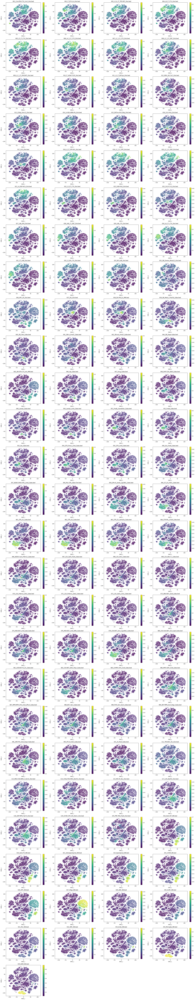

In [8]:
plot_metadata(cistopic_obj,
                 reduction_name='harmony_tech_tSNE',
                 variables=['001_CLA-EPd-CTX_Car3_Glut.bed', '002_IT_EP-CLA_Glut.bed', 
                            '003_L5_6_IT_TPE-ENT_Glut.bed', '004_L6_IT_CTX_Glut.bed', 
                            '005_L5_IT_CTX_Glut.bed', '006_L4_5_IT_CTX_Glut.bed', 
                            '007_L2_3_IT_CTX_Glut.bed', '008_L2_3_IT_ENT_Glut.bed', 
                            '009_L2_3_IT_PIR-ENTl_Glut.bed', '010_IT_AON-TT-DP_Glut.bed',
                            '011_L2_IT_ENT-po_Glut.bed', '012_MEA_Slc17a7_Glut.bed',
                            '013_COAp_Grxcr2_Glut.bed', '014_LA-BLA-BMA-PA_Glut.bed', 
                            '015_ENTmv-PA-COAp_Glut.bed', '016_CA1-ProS_Glut.bed', 
                            '017_CA3_Glut.bed', '018_L2_IT_PPP-APr_Glut.bed', 
                            '019_L2_3_IT_PPP_Glut.bed', '020_L2_3_IT_RSP_Glut.bed', 
                            '021_L4_RSP-ACA_Glut.bed', '022_L5_ET_CTX_Glut.bed', 
                            '023_SUB-ProS_Glut.bed', '025_CA2-FC-IG_Glut.bed', '027_L6b_EPd_Glut.bed', 
                            '028_L6b_CT_ENT_Glut.bed', '029_L6b_CTX_Glut.bed', '030_L6_CT_CTX_Glut.bed',
                            '031_CT_SUB_Glut.bed', '032_L5_NP_CTX_Glut.bed', '033_NP_SUB_Glut.bed',
                            '035_OB_Eomes_Ms4a15_Glut.bed', '036_HPF_CR_Glut.bed', '037_DG_Glut.bed', '038_DG-PIR_Ex_IMN.bed', '039_OB_Meis2_Thsd7b_Gaba.bed', '040_OB_Trdn_Gaba.bed', '041_OB-in_Frmd7_Gaba.bed', '042_OB-out_Frmd7_Gaba.bed', '044_OB_Dopa-Gaba.bed', '045_OB-STR-CTX_Inh_IMN.bed', '046_Vip_Gaba.bed', '047_Sncg_Gaba.bed', '048_RHP-COA_Ndnf_Gaba.bed', '049_Lamp5_Gaba.bed', '050_Lamp5_Lhx6_Gaba.bed', '051_Pvalb_chandelier_Gaba.bed', '052_Pvalb_Gaba.bed',
                            '053_Sst_Gaba.bed', '054_STR_Prox1_Lhx6_Gaba.bed', '055_STR_Lhx8_Gaba.bed', '056_Sst_Chodl_Gaba.bed', '057_NDB-SI-MA-STRv_Lhx8_Gaba.bed', 
                            '058_PAL-STR_Gaba-Chol.bed', '059_GPe-SI_Sox6_Cyp26b1_Gaba.bed', '060_OT_D3_Folh1_Gaba.bed', '061_STR_D1_Gaba.bed', '062_STR_D2_Gaba.bed', '063_STR_D1_Sema5a_Gaba.bed', '064_STR-PAL_Chst9_Gaba.bed', '066_NDB-SI-ant_Prdm12_Gaba.bed', '067_LSX_Sall3_Pax6_Gaba.bed', '068_LSX_Otx2_Gaba.bed', '069_LSX_Nkx2-1_Gaba.bed', '070_LSX_Prdm12_Slit2_Gaba.bed', '071_LSX_Prdm12_Zeb2_Gaba.bed', '072_LSX_Sall3_Lmo1_Gaba.bed', '073_MEA-BST_Sox6_Gaba.bed', '074_MEA-BST_Lhx6_Sp9_Gaba.bed', '076_MEA-BST_Lhx6_Nfib_Gaba.bed', '079_CEA-BST_Six3_Cyp26b1_Gaba.bed', '080_CEA-AAA-BST_Six3_Sp9_Gaba.bed', '081_ACB-BST-FS_D1_Gaba.bed', '082_CEA-BST_Ebf1_Pdyn_Gaba.bed', '085_SI-MPO-LPO_Lhx8_Gaba.bed', '086_MPO-ADP_Lhx8_Gaba.bed', '087_MPN-MPO-LPO_Lhx6_Zfhx3_Gaba.bed', '088_BST_Tac2_Gaba.bed', '089_PVR_Six3_Sox3_Gaba.bed', '090_BST-MPN_Six3_Nrgn_Gaba.bed', '091_ARH-PVi_Six6_Dopa-Gaba.bed', '093_RT-ZI_Gnb3_Gaba.bed', '101_ZI_Pax6_Gaba.bed', '111_TRS-BAC_Sln_Glut.bed', '113_MEA-COA-BMA_Ccdc42_Glut.bed', '114_COAa-PAA-MEA_Barhl2_Glut.bed', '115_MS-SF_Bsx_Glut.bed', '117_LHA_Barhl2_Glut.bed', '118_ADP-MPO_Trp73_Glut.bed', '119_SI-MA-LPO-LHA_Skor1_Glut.bed', 
                            '155_PRC-PAG_Pax6_Glut.bed', '318_Astro-NT_NN.bed', '319_Astro-TE_NN.bed', '321_Astroependymal_NN.bed', '323_Ependymal_NN.bed', '325_CHOR_NN.bed', '326_OPC_NN.bed', '327_Oligo_NN.bed', 
                            '329_ABC_NN.bed', '330_VLMC_NN.bed', '331_Peri_NN.bed', '332_SMC_NN.bed', '333_Endo_NN.bed', '334_Microglia_NN.bed', '335_BAM_NN.bed'], 
                 target='cell', num_columns=4,
                 text_size=10,
              show_label = True,
              show_legend = False,
                 dot_size=0.01,
                 #figsize=(20,40), 
              save = out_dir + 'AU_Cell/signature_scores_Leiden2_5_Zu_paper_DARS_tSNE_tech_harmony.pdf'
             ) 

# subset cistopic obj to matching cell types

To further only focus on the M1 motor cortex in mouse, the cell types are extracted from the larger cistopic obj that due to dissection differences includes a broader range of cell types.

In [13]:
# all samples included, from 29 July
# Load cisTopic object
import pickle
infile = open('/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_16072024_noDBL_130topics.pkl', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

In [5]:
print(cistopic_obj)

CistopicObject from project cisTopic_merge with n_cells × n_regions = 141010 × 1086694


In [7]:
cistopic_obj.cell_data.columns

Index(['Unique_nr_frag_in_regions', 'Doublet_scores_fragments',
       'kde__log_Unique_nr_frag_in_regions__Dupl_rate', 'FRIP',
       'cisTopic_log_nr_acc', 'Dupl_nr_frag', 'Log_unique_nr_frag',
       'TSS_enrichment', 'Predicted_doublets_fragments', 'Log_total_nr_frag',
       'Unique_nr_frag', 'kde__log_Unique_nr_frag_in_regions__TSS_enrichment',
       'barcode', 'cisTopic_nr_frag', 'cisTopic_nr_acc',
       'cisTopic_log_nr_frag', 'kde__log_Unique_nr_frag_in_regions__FRIP',
       'pycisTopic_leiden_10_1.2', 'pycisTopic_leiden_10_2',
       'pycisTopic_leiden_10_0.6', 'sample_id', 'Total_nr_frag_in_regions',
       'pycisTopic_leiden_10_2.5', 'Dupl_rate', 'Total_nr_frag',
       'preliminary_mouse_annot_23072024', 'refined_annot',
       'refined_annot_simple', 'beads', 'tech', 'sample_prep',
       'Zu_paper_lift_over', 'tech_simple', 'Zu_paper_lift_over_simple',
       'techxZu_paper_lift_over_simple', 'dict_BICCN_corrected_08112024'],
      dtype='object')

In [10]:
#inspecting the number of cells per platform
sample_counts = cistopic_obj.cell_data['tech_simple'].value_counts().to_dict()
print(sample_counts)

{'HyDrop_v2': 110547, '10x_v2': 13123, '10x_v1': 10177, 'HyDrop_v1': 7163}


In [11]:
#inspecting the number of cells per cell type
sample_counts = cistopic_obj.cell_data['dict_BICCN_corrected_08112024'].value_counts().to_dict()
print(sample_counts)

{'limbic_system': 20669, 'Oligo': 18921, 'L2_3_IT': 12813, 'D1_2_STR_INH': 10575, 'L4_IT': 9148, 'L6_CT': 7480, 'Astro': 7019, 'L5_IT': 6108, 'Micro_PVM': 5917, 'OPC': 4317, 'L6_IT': 4258, 'Pvalb': 3725, 'Hippocampus_DG': 3045, 'L5_ET': 2725, 'EXC_L2_IT_ENT_PPP': 2632, 'Sst': 2381, 'EXC_PIR_L2_3_prime_ENT': 2198, 'OB': 2134, 'Hippocampus_CA1': 2084, 'INH_STR_OT_D3': 1968, 'Lamp5': 1845, 'L6b': 1638, 'L5_6_NP': 1569, 'IT_AON_TT_DP': 1527, 'Sncg_Vip': 1479, 'Endo_VLMC': 1020, 'CLA_EPd_L6_IT_Car3_plus_CTX': 865, 'L2_3_IT_RsP_EXC': 764, 'Astroependymal_NN': 97, 'NA': 89}


In [15]:
#how many cell types are present in data from each platform?
tech_sample_counts = cistopic_obj.cell_data.groupby('tech_simple')['dict_BICCN_corrected_08112024'].nunique()
print(tech_sample_counts)

tech_simple
10x_v1       24
10x_v2       26
HyDrop_v1    27
HyDrop_v2    30
Name: dict_BICCN_corrected_08112024, dtype: int64


In [16]:
#how many cell types are present in data from each platform?
tech_sample_counts = cistopic_obj.cell_data.groupby('dict_BICCN_corrected_08112024')['tech_simple'].nunique()
print(tech_sample_counts)

dict_BICCN_corrected_08112024
Astro                          4
Astroependymal_NN              2
CLA_EPd_L6_IT_Car3_plus_CTX    4
D1_2_STR_INH                   3
EXC_L2_IT_ENT_PPP              4
EXC_PIR_L2_3_prime_ENT         2
Endo_VLMC                      4
Hippocampus_CA1                3
Hippocampus_DG                 2
INH_STR_OT_D3                  4
IT_AON_TT_DP                   3
L2_3_IT                        4
L2_3_IT_RsP_EXC                3
L4_IT                          4
L5_6_NP                        4
L5_ET                          4
L5_IT                          4
L6_CT                          4
L6_IT                          4
L6b                            4
Lamp5                          4
Micro_PVM                      4
NA                             1
OB                             4
OPC                            4
Oligo                          4
Pvalb                          4
Sncg_Vip                       4
Sst                            4
limbic_system

select only the **mouse primary motor cortex - M1** cell types: L2_3_IT, L5_IT, L6_IT, L5_ET, L5_6_NP, L6_CT, L6b, Lamp5, Sncg_Vip (ideally 2 cell types), Sst, Pvalb, Astro, OPC, Oligo,  Endo_VLMC (ideally two cell types), Micro_PVM matching Johanson et al. (2024) https://www.biorxiv.org/content/10.1101/2024.08.21.609075v1

In [27]:
# add new variable 
motor_types = {
    'L2_3_IT', 'L5_IT', 'L6_IT', 
    'L4_IT', #include to rename later on
    'L5_ET', 'L5_6_NP', 'L6_CT', 'L6b',
    'Lamp5', 'Sncg_Vip',
    'Sst', 'Pvalb',
    'Astro', 'OPC', 'Oligo',
    'Endo_VLMC',   
    'Micro_PVM'  
}

cistopic_obj.cell_data['region_label'] = cistopic_obj.cell_data['dict_BICCN_corrected_08112024'].apply(
    lambda ct: 'motor_cortex' if ct in motor_types else 'non_motor_cortex'
)

print(cistopic_obj.cell_data['region_label'].value_counts())


region_label
motor_cortex        92363
non_motor_cortex    48647
Name: count, dtype: int64


In [22]:
cistopic_obj.projections

{'cell': {'UMAP':                                                        UMAP_1     UMAP_2
  GAGCTAGTAAATCTCAACAGATGAAGTGCG___HYA__combined_...  13.679079  -8.735878
  GAGCTAGTAACCGGTTACATATGAAGTGCG___HYA__combined_...  13.699461  -8.737360
  TAGCTGTTGGATAGGTACGGCCTTCGTTAA___HYA__combined_...  10.193606  -4.916841
  ACTAATGACGGACGGACGGTCGAACTTCCT___HYA__combined_...  12.307623   2.464874
  GACCAATCGAAGCTTGAGAGTGACGAGATG___HYA__combined_...  14.920617   3.405721
  ...                                                       ...        ...
  ACCAGACGTAATTCGGTCAGAGAACAATCC___HYA__combined_...  -5.569001   4.169872
  AGTTGGAAGAGGCTTGAGAGCATCTCAGGT___HYA__combined_...  -6.877809   5.680140
  GAGGTACTACCAACCAACGGCACAAGCATT___HYA__combined_...  -2.429142  14.772616
  ACCTCGAATCGACGGACGGTCGTCATCCTA___HYA__combined_...  -2.056001  15.498142
  CCATCTCTGTATCAGAAGAAAAGTGTAGAA___HYA__combined_...  -6.440274   4.681892
  
  [141010 rows x 2 columns],
  'tSNE':                                           

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x150f876840e0> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x150f876840e0> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

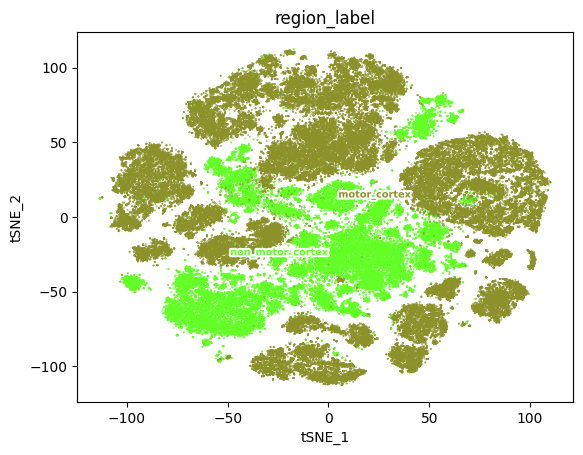

In [28]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_tSNE',
    variables=['region_label'],
    target='cell', num_columns=1,
    remove_nan = False,
    text_size=7,
    dot_size=0.1,
 #save = out_dir + 'visualization/harmony_tech_tSNE.pdf'
)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x150f876840e0> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x150f876840e0> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

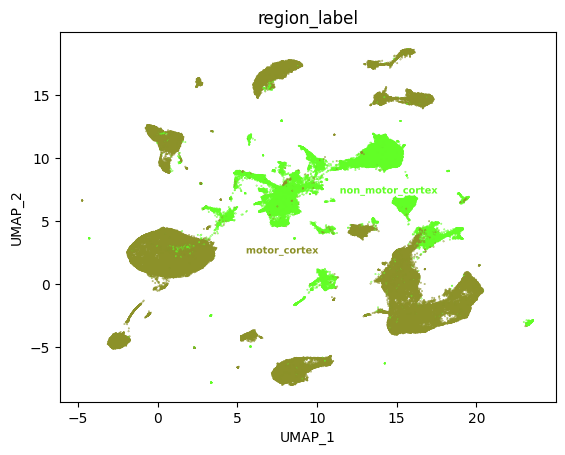

In [29]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_UMAP',
    variables=['region_label'],
    target='cell', num_columns=1,
    remove_nan = False,
    text_size=7,
    dot_size=0.1,
 #save = out_dir + 'visualization/harmony_tech_tSNE.pdf'
)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x150f876840e0> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x150f876840e0> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

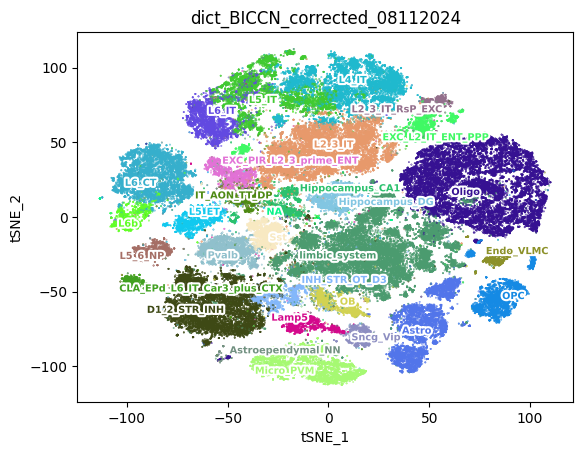

In [30]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_tSNE',
    variables=['dict_BICCN_corrected_08112024'],
    target='cell', num_columns=1,
    remove_nan = False,
    text_size=7,
    dot_size=0.1,
 #save = out_dir + 'visualization/harmony_tech_tSNE.pdf'
)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x150f876840e0> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x150f876840e0> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

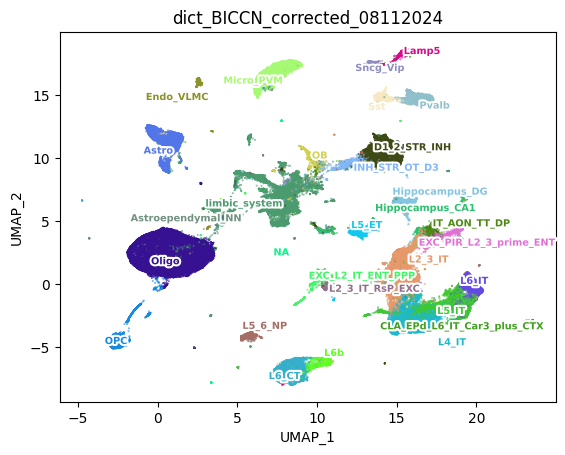

In [31]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_UMAP',
    variables=['dict_BICCN_corrected_08112024'],
    target='cell', num_columns=1,
    remove_nan = False,
    text_size=7,
    dot_size=0.1,
 #save = out_dir + 'visualization/harmony_tech_tSNE.pdf'
)

In [32]:
#Leave in =  Define the conditions
conditions = ['motor_cortex']

# Filter the cells based on pycisTopic_leiden_10_0.6
filtered_cells = cistopic_obj.cell_data[cistopic_obj.cell_data['region_label'].isin(conditions)]

# Get the list of cell IDs
cell_ids_list = filtered_cells.index.tolist()

# Create a new cistopic object with the filtered cells
new_object_atlas = cistopic_obj.subset(cell_ids_list, copy=True)

In [33]:
print(cistopic_obj)

CistopicObject from project cisTopic_merge with n_cells × n_regions = 141010 × 1086694


In [34]:
print(new_object_atlas)

CistopicObject from project cisTopic_merge with n_cells × n_regions = 92363 × 1086694


In [35]:
pwd

'/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic'

In [38]:
pickle.dump(
    new_object_atlas,
    open(os.path.join(out_dir, "cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025.pkl"), "wb")
)

# topic modelling

submit topic modelling as job

## model evaluation

In [6]:
# all samples included, from 29 July
# Load cisTopic object
import pickle
infile = open(out_dir +'cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025.pkl', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

In [4]:
import os
import pickle
model_folder = out_dir +"cistopic_objs/models/"
models = [
   pickle.load(open(os.path.join(model_folder, model_fname), "rb"))
   for model_fname in os.listdir(model_folder)]

In [7]:
from pycisTopic.lda_models import evaluate_models
model = evaluate_models(
    models,
    metrics=['Arun_2010','Cao_Juan_2009', 'Minmo_2011'],
    select_model = None,
    return_model = True
)

AttributeError: 'list' object has no attribute 'n_topic'

In [29]:
cistopic_obj.add_LDA_model(model)

In [30]:
find_clusters(
    cistopic_obj,
    target  = 'cell',
    k = 10,
    res = [0.6,1.2,2,2.5],
    prefix = 'pycisTopic_',
    scale = True,
    split_pattern = '-'
)

2025-06-11 09:38:46,551 cisTopic     INFO     Finding neighbours
Columns ['pycisTopic_leiden_10_0.6'] will be overwritten
Columns ['pycisTopic_leiden_10_1.2'] will be overwritten
Columns ['pycisTopic_leiden_10_2'] will be overwritten
Columns ['pycisTopic_leiden_10_2.5'] will be overwritten


In [31]:
run_umap(
    cistopic_obj,
    target  = 'cell', scale=True)

2025-06-11 09:39:32,365 cisTopic     INFO     Running UMAP


/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [32]:
run_tsne(
    cistopic_obj,
    target  = 'cell', scale=True)

2025-06-11 09:40:55,337 cisTopic     INFO     Running TSNE


In [33]:
import pickle
pickle.dump(
    cistopic_obj,
    open(os.path.join(out_dir, "cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025_130topics.pkl"), "wb")
)

# visualization

In [37]:
#after models - models are submitted
# Load cisTopic object
import pickle
infile = open(out_dir + 'cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025_130topics.pkl', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

In [13]:
print(cistopic_obj.cell_data.columns)

Index(['Unique_nr_frag', 'Total_nr_frag_in_regions', 'beads', 'barcode',
       'cisTopic_log_nr_acc', 'Dupl_nr_frag',
       'preliminary_mouse_annot_23072024', 'pycisTopic_leiden_10_0.6',
       'tech_simple', 'pycisTopic_leiden_10_2', 'sample_prep',
       'Zu_paper_lift_over_simple', 'FRIP',
       'kde__log_Unique_nr_frag_in_regions__TSS_enrichment',
       'Unique_nr_frag_in_regions', 'Dupl_rate', 'refined_annot',
       'refined_annot_simple', 'kde__log_Unique_nr_frag_in_regions__Dupl_rate',
       'cisTopic_log_nr_frag', 'pycisTopic_leiden_10_1.2', 'cisTopic_nr_frag',
       'dict_BICCN_corrected_08112024', 'region_label',
       'Doublet_scores_fragments', 'Zu_paper_lift_over',
       'kde__log_Unique_nr_frag_in_regions__FRIP', 'cisTopic_nr_acc',
       'sample_id', 'techxZu_paper_lift_over_simple', 'tech', 'TSS_enrichment',
       'Predicted_doublets_fragments', 'Total_nr_frag', 'Log_unique_nr_frag',
       'Log_total_nr_frag', 'pycisTopic_leiden_10_2.5'],
      dtype='object

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

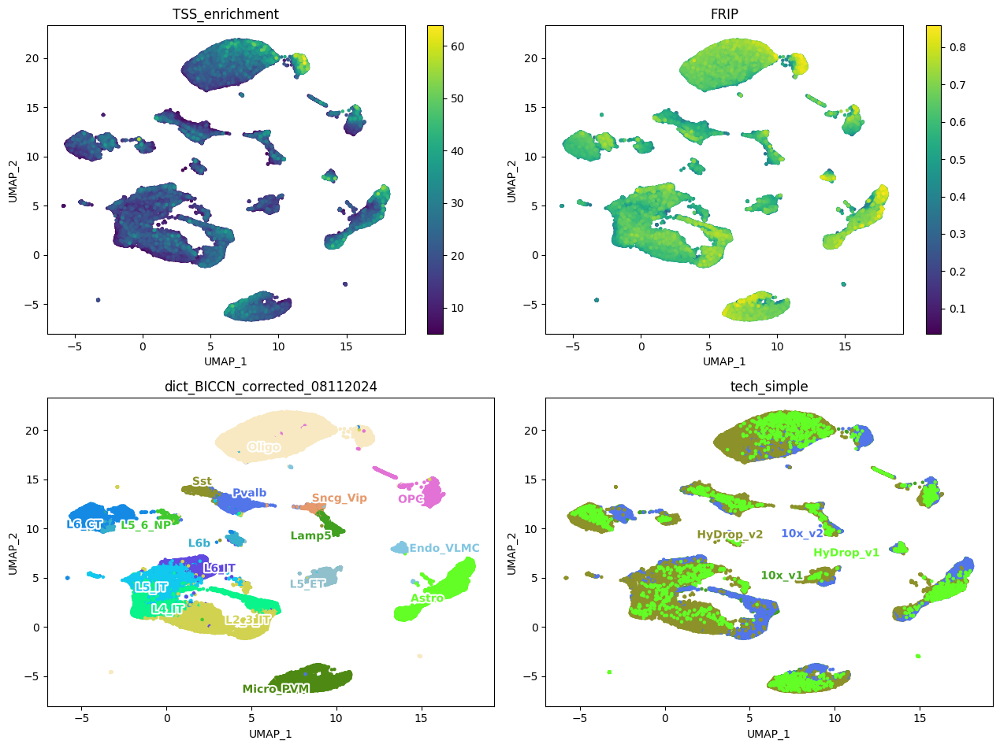

In [19]:
# model 90 topics
plot_metadata(
    cistopic_obj,
    reduction_name='UMAP',
    variables=['TSS_enrichment', 'FRIP', 'dict_BICCN_corrected_08112024', 'tech_simple'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=5)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

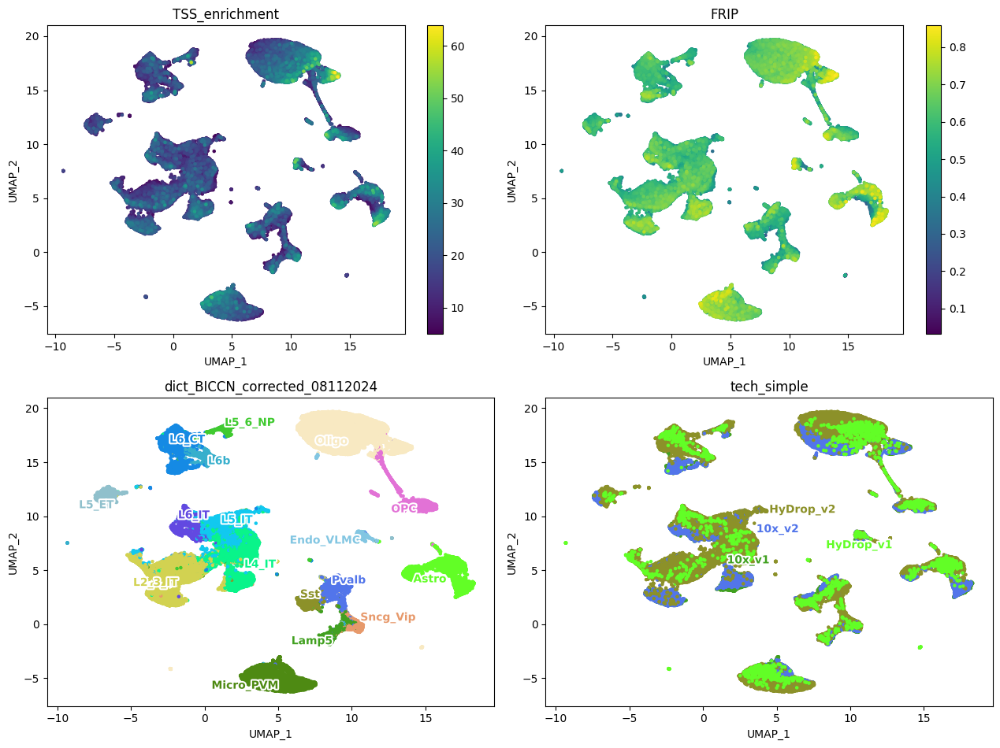

In [34]:
# model 130 topics
plot_metadata(
    cistopic_obj,
    reduction_name='UMAP',
    variables=['TSS_enrichment', 'FRIP', 'dict_BICCN_corrected_08112024', 'tech_simple'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=5)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

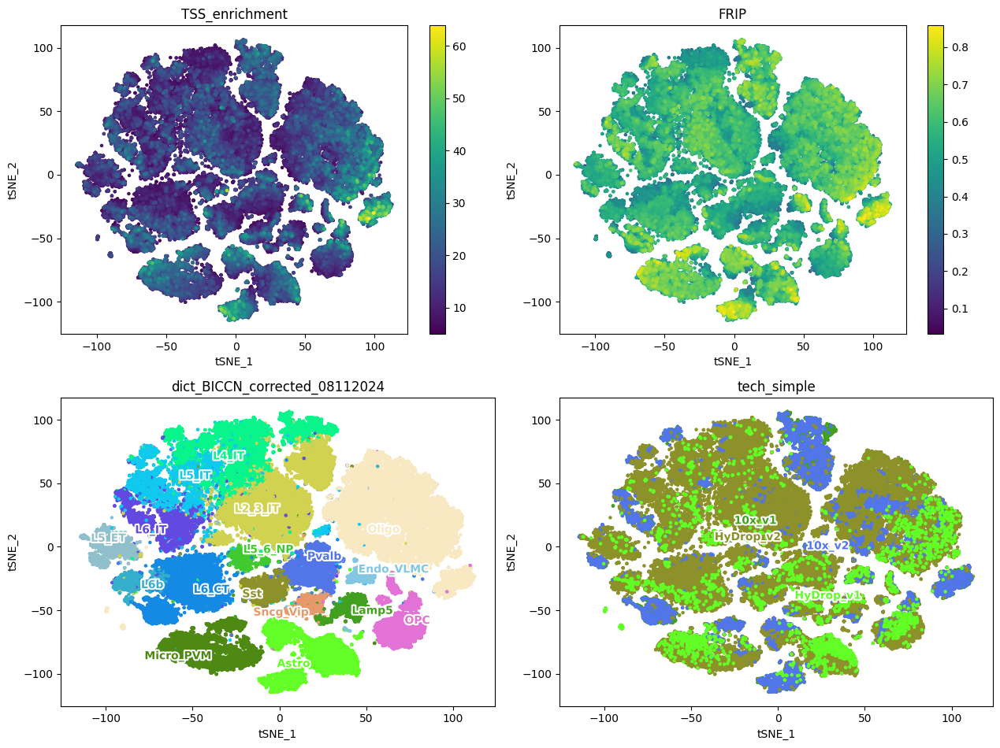

In [20]:
# model 90
plot_metadata(
    cistopic_obj,
    reduction_name='tSNE',
    variables=['TSS_enrichment', 'FRIP', 'dict_BICCN_corrected_08112024', 'tech_simple'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=5)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

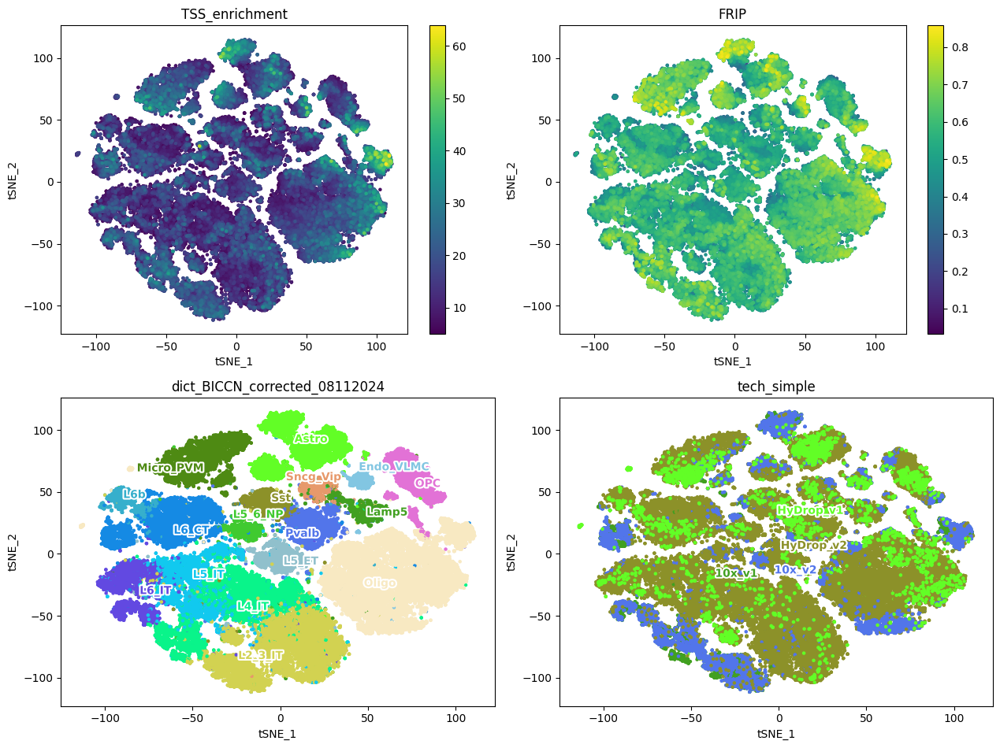

In [35]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='tSNE',
    variables=['TSS_enrichment', 'FRIP', 'dict_BICCN_corrected_08112024', 'tech_simple'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=5)

# harmony on tech variable 

Harmony on tech simple (HyDrop v2, HyDrop v1, 10x v2 and 10x v1). According to a recent benchmarking study on scATAC platforms, Harmony batch correction is the most efficient using the platform as variable (https://www.nature.com/articles/s41587-023-01881-x)

In [36]:
#on 90 topics
from pycisTopic.clust_vis import *
harmony(cistopic_obj, 'tech_simple', random_state=555)

2025-06-11 09:44:57,165 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


2025-06-11 09:44:57,165 harmonypy    INFO     Computing initial centroids with sklearn.KMeans...


2025-06-11 09:45:12,992 - harmonypy - INFO - sklearn.KMeans initialization complete.


2025-06-11 09:45:12,992 harmonypy    INFO     sklearn.KMeans initialization complete.


2025-06-11 09:45:13,390 - harmonypy - INFO - Iteration 1 of 10


2025-06-11 09:45:13,390 harmonypy    INFO     Iteration 1 of 10


2025-06-11 09:45:32,868 - harmonypy - INFO - Iteration 2 of 10


2025-06-11 09:45:32,868 harmonypy    INFO     Iteration 2 of 10


2025-06-11 09:45:51,833 - harmonypy - INFO - Iteration 3 of 10


2025-06-11 09:45:51,833 harmonypy    INFO     Iteration 3 of 10


2025-06-11 09:46:10,431 - harmonypy - INFO - Converged after 3 iterations


2025-06-11 09:46:10,431 harmonypy    INFO     Converged after 3 iterations


In [37]:
run_umap(cistopic_obj, reduction_name='harmony_tech_UMAP',
                target  = 'cell', harmony=True)
run_tsne(cistopic_obj, reduction_name='harmony_tech_tSNE',
                 target  = 'cell', harmony=True)

2025-06-11 09:46:10,453 cisTopic     INFO     Running UMAP


/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


2025-06-11 09:47:31,333 cisTopic     INFO     Running TSNE


In [38]:
import pickle
pickle.dump(
    cistopic_obj,
    open(os.path.join(out_dir, "cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025_130topics.pkl"), "wb")
)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

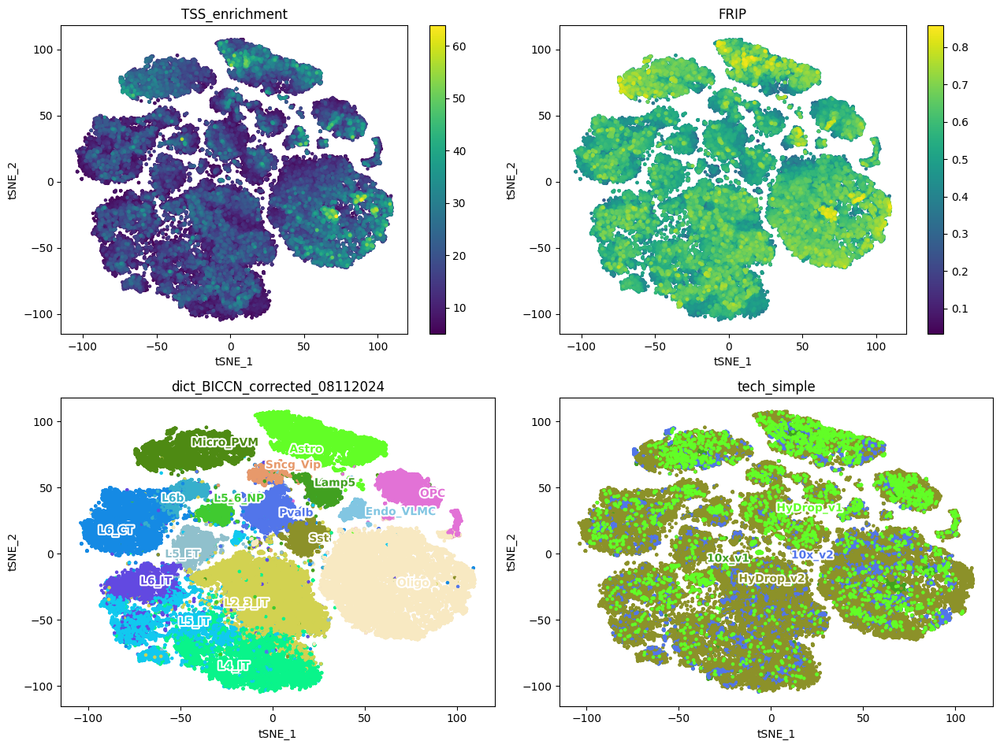

In [24]:
# model 90
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_tSNE',
    variables=['TSS_enrichment', 'FRIP', 'dict_BICCN_corrected_08112024', 'tech_simple'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=5)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

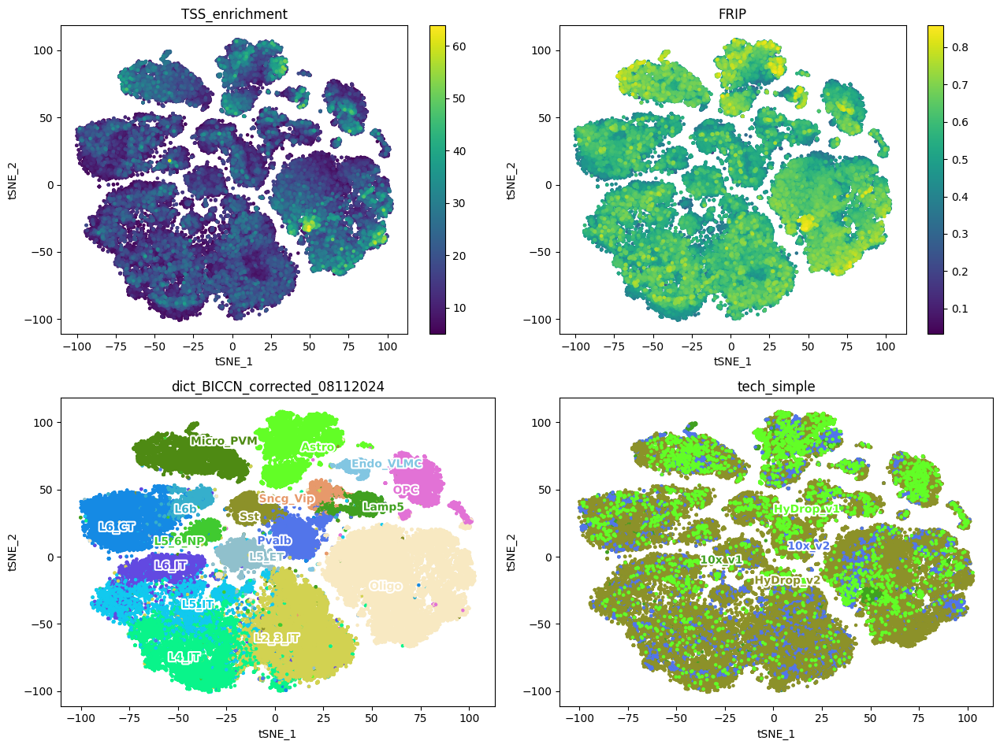

In [39]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_tSNE',
    variables=['TSS_enrichment', 'FRIP', 'dict_BICCN_corrected_08112024', 'tech_simple'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=5)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

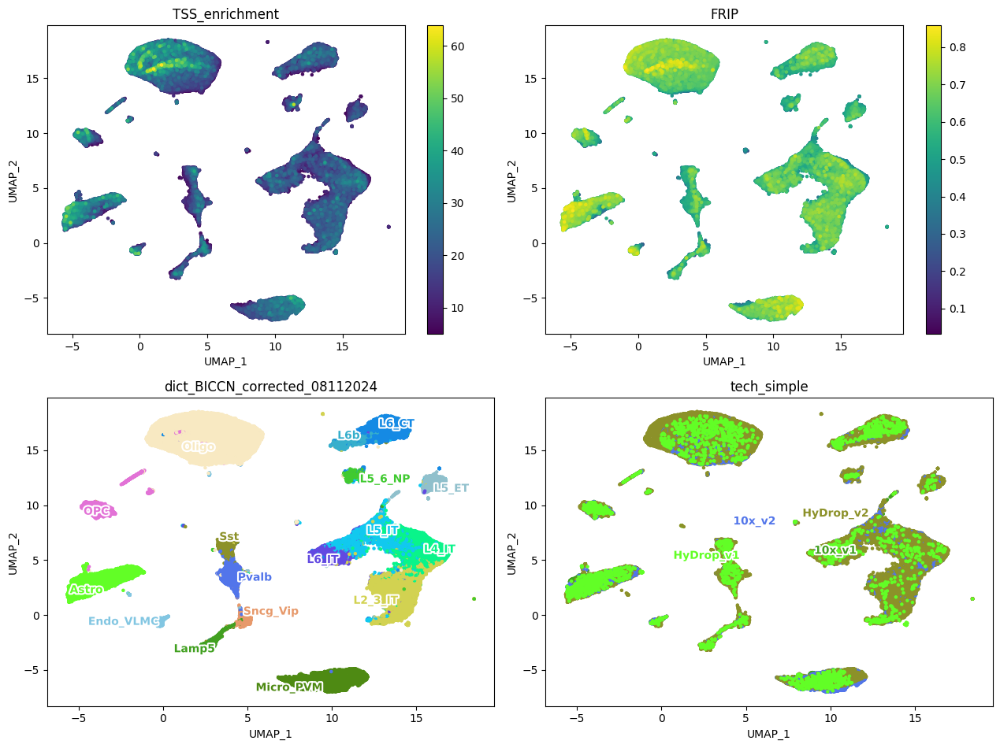

In [25]:
# model 90
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_UMAP',
    variables=['TSS_enrichment', 'FRIP', 'dict_BICCN_corrected_08112024', 'tech_simple'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=5)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

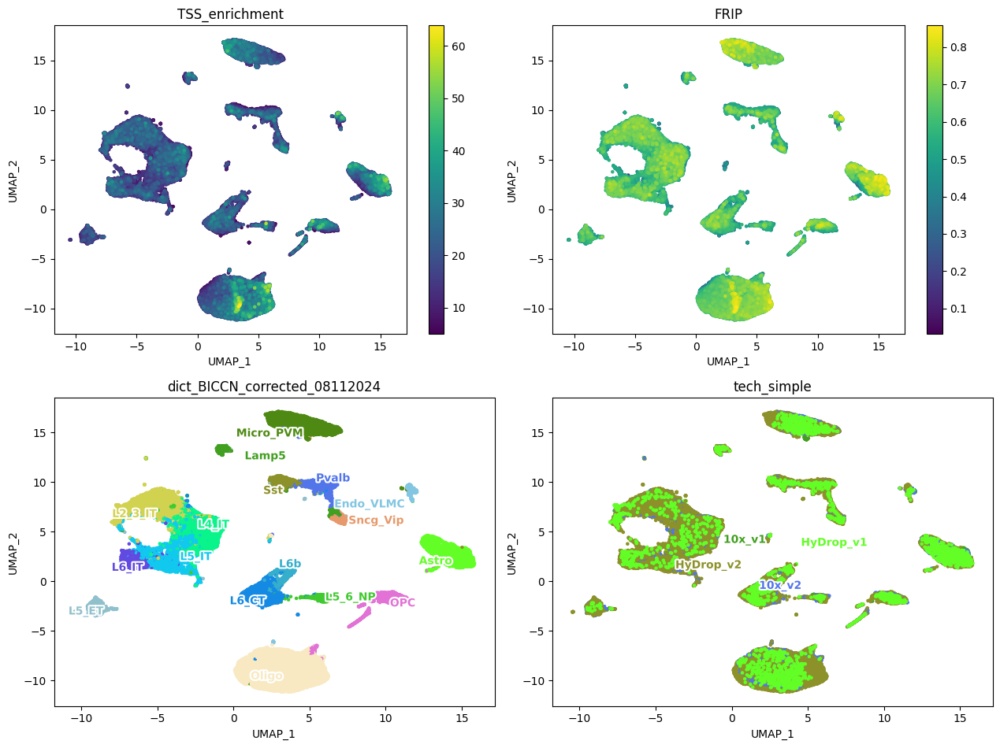

In [40]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_UMAP',
    variables=['TSS_enrichment', 'FRIP', 'dict_BICCN_corrected_08112024', 'tech_simple'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=5)

# annotation

refine annotation based on M1 dataset https://www.biorxiv.org/content/10.1101/2024.08.21.609075v1

continue with cistopic obj with 130 topiccs & plot different Leiden resolutions to see which one represents best the preliminary annotations

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

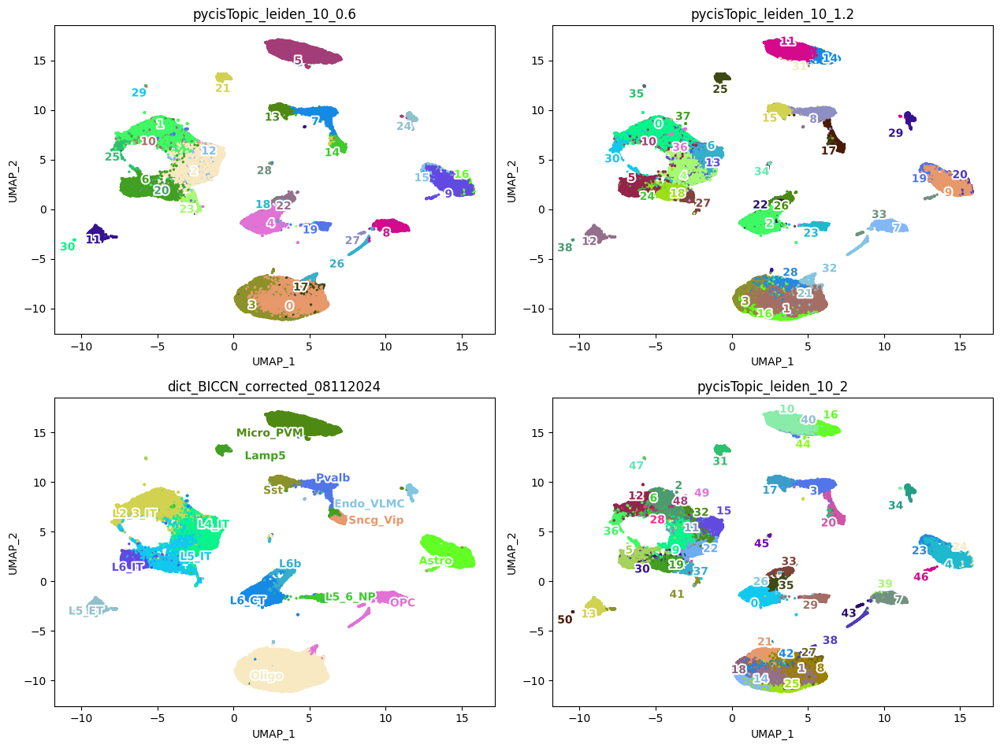

In [43]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_UMAP',
    variables=['pycisTopic_leiden_10_0.6', 'pycisTopic_leiden_10_1.2', 'dict_BICCN_corrected_08112024', 'pycisTopic_leiden_10_2'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=2)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

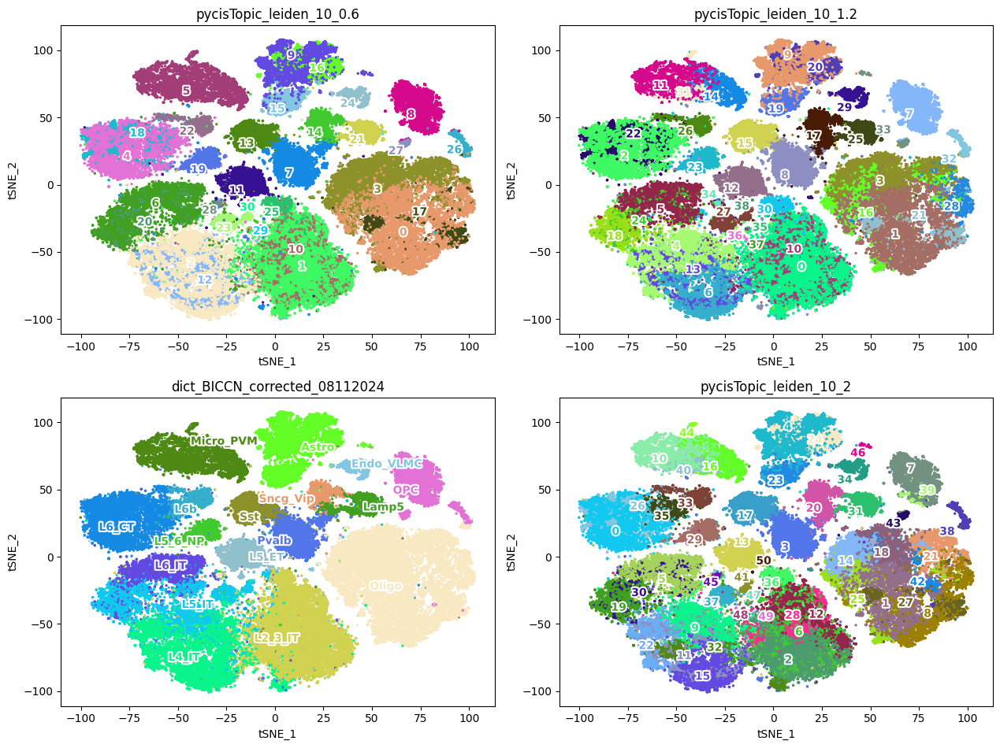

In [45]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_tSNE',
    variables=['pycisTopic_leiden_10_0.6', 'pycisTopic_leiden_10_1.2', 'dict_BICCN_corrected_08112024', 'pycisTopic_leiden_10_2'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=2)

Refine annotationw with Leiden resolution 0.6 (we could even go lower but this is also fine)

## generate pseudobulk for Leiden resolution 0.6

we generate pseudobulk bw files so we can investigate the accessibility of DARs across the clusters to reannotate them manually

In [46]:
fragments_dict = {'HYA__76b206__20240430_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__76b206__20240430_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'atac_v1_adult_brain_fresh_5k': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/atac_v1_adult_brain_fresh_5k.fragments.tsv.gz',
 'HYA__ba8433__20231116_HyATAC_MouseCortex_B2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__ba8433__20231116_HyATAC_MouseCortex_B2.fragments.tsv.gz',
 'HYA__177788__20240117_Mouse_Cortex-d-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__177788__20240117_Mouse_Cortex-d-ATAC.fragments.tsv.gz',
 'HYA__67df33__20240105_Mouse_Cortex-d-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__67df33__20240105_Mouse_Cortex-d-ATAC.fragments.tsv.gz',
 'HYA__b606e2__20240117_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__b606e2__20240117_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'HYA__e9082f__20240430_Mouse_Cortex-d-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__e9082f__20240430_Mouse_Cortex-d-ATAC.fragments.tsv.gz',
 'HYA__e1bdab__20230829_mouse_cortex_2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__e1bdab__20230829_mouse_cortex_2.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-5': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2.fragments.tsv.gz',
 'HYA__955707__20240304_Mouse_Cortex-b2-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__955707__20240304_Mouse_Cortex-b2-ATAC.fragments.tsv.gz',
 'HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-4': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4.fragments.tsv.gz',
'HYA__7ad445__20231031_HyDropAtac_MouseCortex_A1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__7ad445__20231031_HyDropAtac_MouseCortex_A1.fragments.tsv.gz',
 'HYA__853a40__20240304_Mouse_Cortex-b1-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__853a40__20240304_Mouse_Cortex-b1-ATAC.fragments.tsv.gz',
 'HYA__fcb55f__20231013_HyDropATAC_MouseCortex_B': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__fcb55f__20231013_HyDropATAC_MouseCortex_B.fragments.tsv.gz',
 'HYA__ac683b__20230829_mouse_cortex_1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__ac683b__20230829_mouse_cortex_1.fragments.tsv.gz',
 'HYA__14fb45__20231013_HyDropATAC_MouseCortex_D': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__14fb45__20231013_HyDropATAC_MouseCortex_D.fragments.tsv.gz',
 'HYA__30fc7f__20231031_HyDropAtac_MouseCortex_D1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__30fc7f__20231031_HyDropAtac_MouseCortex_D1.fragments.tsv.gz',
 'HYA__3eb2c7__20240221_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__3eb2c7__20240221_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__831196__20240105_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__831196__20240105_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'HYA__8d1d23__20231116_HyATAC_MouseCortex_C1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__8d1d23__20231116_HyATAC_MouseCortex_C1.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-3': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-3.fragments.tsv.gz',
 'HYA__cc24b7__20240304_Mouse_Cortex-c-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__cc24b7__20240304_Mouse_Cortex-c-ATAC.fragments.tsv.gz',
 '8k_mouse_cortex_ATACv2_nextgem_Chromium_Controller': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/8k_mouse_cortex_ATACv2_nextgem_Chromium_Controller.fragments.tsv.gz',
 'HYA__a7a748__20231031_HyDropAtac_MouseCortex_C2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__a7a748__20231031_HyDropAtac_MouseCortex_C2.fragments.tsv.gz',
 'HYA__167ec9__20240304_Mouse_Cortex-a2-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__167ec9__20240304_Mouse_Cortex-a2-ATAC.fragments.tsv.gz',
'HYA__247495__20231013_HyDropATAC_MouseCortex_C': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__247495__20231013_HyDropATAC_MouseCortex_C.fragments.tsv.gz',
 'HYA__87f862__20240117_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__87f862__20240117_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__7e2d51__20231031_HyDropAtac_MouseCortex_B1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__7e2d51__20231031_HyDropAtac_MouseCortex_B1.fragments.tsv.gz',
 'HYA__00c24b__20240117_Mouse_Cortex-c-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__00c24b__20240117_Mouse_Cortex-c-ATAC.fragments.tsv.gz',
 'HYA__fd6250__20240105_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__fd6250__20240105_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__c0d7e5__20240304_Mouse_Cortex-a1-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__c0d7e5__20240304_Mouse_Cortex-a1-ATAC.fragments.tsv.gz',
 'HYA__3e5c73__20231031_HyDropAtac_MouseCortex_D2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__3e5c73__20231031_HyDropAtac_MouseCortex_D2.fragments.tsv.gz',
 'HYA__9667aa__20231116_HyATAC_MouseCortex_C2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__9667aa__20231116_HyATAC_MouseCortex_C2.fragments.tsv.gz',
 'HYA__66fdea__20231116_HyATAC_MouseCortex_B1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__66fdea__20231116_HyATAC_MouseCortex_B1.fragments.tsv.gz',
 'HYA__2eb25d__20240430_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__2eb25d__20240430_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__21de27__20240105_Mouse_Cortex-c-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__21de27__20240105_Mouse_Cortex-c-ATAC.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1.fragments.tsv.gz',
 'HYA__d4ff32__20231116_HyATAC_MouseCortex_A': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__d4ff32__20231116_HyATAC_MouseCortex_A.fragments.tsv.gz',
 'HYA__6b44d3__20240221_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__6b44d3__20240221_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'HYA__7a1cc3__20231013_HyDropATAC_MouseCortex_A': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__7a1cc3__20231013_HyDropATAC_MouseCortex_A.fragments.tsv.gz',
 'HYA__0f6aa5__20231031_HyDropAtac_MouseCortex_B2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__0f6aa5__20231031_HyDropAtac_MouseCortex_B2.fragments.tsv.gz',
 '8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X.fragments.tsv.gz'}

In [48]:
import pandas as pd
chromsizes = pd.read_table(
    "http://hgdownload.cse.ucsc.edu/goldenPath/mm10/bigZips/mm10.chrom.sizes",
    header = None,
    names = ["Chromosome", "End"]
)
chromsizes.insert(1, "Start", 0)
chromsizes.head()

,Chromosome,Start,End
0,chr1,0,195471971
1,chr2,0,182113224
2,chrX,0,171031299
3,chr3,0,160039680
4,chr4,0,156508116


In [50]:
tmp_dir = '/scratch/leuven/350/vsc35050/'

In [51]:
from pycisTopic.pseudobulk_peak_calling import *
bw_paths, bed_paths = export_pseudobulk(input_data = cistopic_obj.cell_data,
                 variable = 'pycisTopic_leiden_10_0.6',
                 sample_id_col = 'sample_id',
                 chromsizes = chromsizes,
                 bed_path = out_dir + 'pseudobulk/Leiden_0_6/pseudobulk_bed_files/',
                 bigwig_path = out_dir + 'pseudobulk/Leiden_0_6/pseudobulk_bw_files/',
                 path_to_fragments = fragments_dict,
                 n_cpu = 40,
                 normalize_bigwig = True,
                 #remove_duplicates = True,
                 temp_dir = tmp_dir + 'ray_spill',
                 split_pattern = '___')

2025-06-11 10:18:07,084 cisTopic     INFO     Splitting fragments by cell type.


[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/atac_v1_adult_brain_fresh_5k.fragments.tsv.gz.tbi
[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__30fc7f__20231031_HyDropAtac_MouseCortex_D1.fragments.tsv.gz.tbi
[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1.fragments.tsv.gz.tbi
[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__66fdea__20231116_HyATAC_MouseCortex_B1.fragments.tsv.gz.tbi
[W::hts_idx_load3] The index file is older than the data file: /lustre1

2025-06-11 10:22:57,353 cisTopic     INFO     generating bigwig files


## reannotate

In IGV, we check for accessibility of the DARs and match the annotation to the Leiden pseudobulk resolution.

In [52]:
sample_counts = cistopic_obj.cell_data['pycisTopic_leiden_10_0.6'].value_counts().to_dict()
print(sample_counts)

{'0': 9592, '1': 9337, '2': 7987, '3': 7492, '4': 6198, '5': 5906, '6': 5745, '7': 3914, '8': 3634, '9': 3531, '10': 3187, '11': 2689, '12': 2514, '13': 2327, '14': 1848, '15': 1756, '16': 1728, '17': 1611, '18': 1586, '19': 1562, '20': 1561, '21': 1517, '22': 1291, '23': 1155, '24': 990, '25': 742, '26': 584, '27': 201, '28': 95, '29': 71, '30': 12}


In [53]:
clustering_resolution = 'pycisTopic_leiden_10_0.6'
annotation_key = 'dict_BICCN_corrected_08112024'

cluster_to_annot = {}
mapping_dict = {}
for name, df in cistopic_obj.cell_data.groupby(clustering_resolution):
    number_of_cells = len(df)
    value_counts = df[annotation_key].value_counts()
    print(name)
    print(number_of_cells)
    print(value_counts)
    print(value_counts/number_of_cells)
    print(sum(value_counts))
    val_con = value_counts/number_of_cells



annot_counts = cistopic_obj.cell_data['pycisTopic_leiden_10_0.6'].value_counts().to_dict()

print(annot_counts)

0
9592
dict_BICCN_corrected_08112024
Oligo      9559
OPC          20
L4_IT         5
L6_CT         3
L6_IT         1
Sst           1
L2_3_IT       1
L5_IT         1
L6b           1
Name: count, dtype: int64
dict_BICCN_corrected_08112024
Oligo      0.996560
OPC        0.002085
L4_IT      0.000521
L6_CT      0.000313
L6_IT      0.000104
Sst        0.000104
L2_3_IT    0.000104
L5_IT      0.000104
L6b        0.000104
Name: count, dtype: float64
9592
1
9337
dict_BICCN_corrected_08112024
L2_3_IT      8517
L4_IT         619
L5_IT         113
L6_IT          26
L6_CT          23
L5_ET          11
L5_6_NP         8
Lamp5           7
L6b             5
Micro_PVM       2
Sncg_Vip        2
OPC             1
Sst             1
Astro           1
Oligo           1
Name: count, dtype: int64
dict_BICCN_corrected_08112024
L2_3_IT      0.912177
L4_IT        0.066295
L5_IT        0.012102
L6_IT        0.002785
L6_CT        0.002463
L5_ET        0.001178
L5_6_NP      0.000857
Lamp5        0.000750
L6b        

In [90]:
cleaned_up_annot_dict = {'0': 'Oligo', #real
                         '1': 'L2_3_IT', 
                         '2': 'L5_IT', # unclear L5_IT is second
                         '3': 'Oligo', # real
                         '4': 'L6_CT', 
                         '5': 'Micro_PVM', 
                         '6': 'L6_IT',
                         '7': 'Pvalb', 
                         '8': 'OPC', #main OPC
                         '9': 'Astro', 
                         '10': 'L2_3_IT', 
                         '11': 'L5_ET', 
                         '12': 'L5_IT', # unclear, is the second L2_3_IT
                         '13': 'Sst', 
                         '14': 'Sncg_Vip', 
                         '15': 'Astro', 
                         '16': 'Astro', 
                         '17': 'Oligo', #real
                         '18': 'L6_CT', 
                         '19': 'L5_6_NP', 
                         '20': 'L6_IT', 
                         '21': 'Lamp5', 
                         '22': 'L6b', 
                         '23': 'L5_IT', 
                         '24': 'Endo_VLMC', #1
                         '25': 'L2_3_IT', # unclear
                         '26': 'OPC', #1 - unclear
                         '27': 'OPC', #2 - unclear
                         '28': 'Oligo', #unclear
                         '29': 'Oligo', #unclear
                         '30': 'L5_ET'
                        }

In [91]:
for number, new_value in cleaned_up_annot_dict.items():
    cistopic_obj.cell_data.loc[
        cistopic_obj.cell_data["pycisTopic_leiden_10_0.6"] == number, "cleaned_up_annot"] = new_value

In [92]:
import pickle
pickle.dump(
    cistopic_obj,
    open(os.path.join(out_dir, "cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025_130topics.pkl"), "wb")
)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

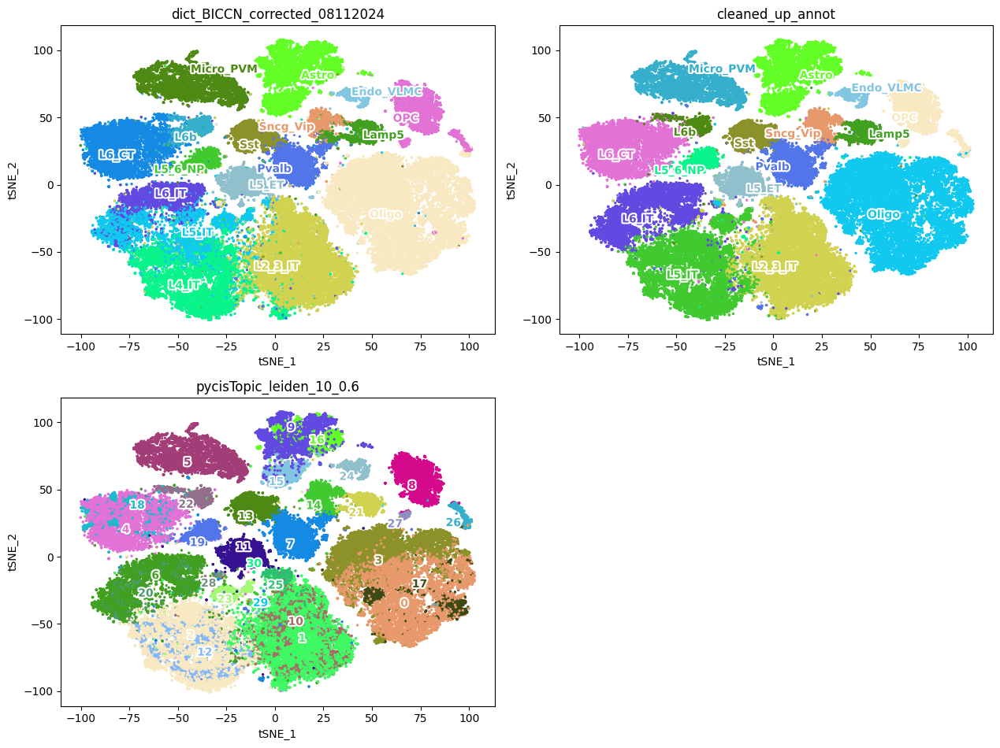

In [62]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='harmony_tech_tSNE',
    variables=['dict_BICCN_corrected_08112024', 'cleaned_up_annot', 'pycisTopic_leiden_10_0.6'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=2)

/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:519: FutureWarning: The provided callable <function mean at 0x14fab00d4180> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  label_pos = label_pd.groupby(var).agg(
/lustre1/project/stg_00002/mambaforge/vsc34498/envs/pycistopic_polars_feb25/lib/python3.11/site-packages/pycisTopic/clust_vis.py:526: FutureWarning: Series.__getite

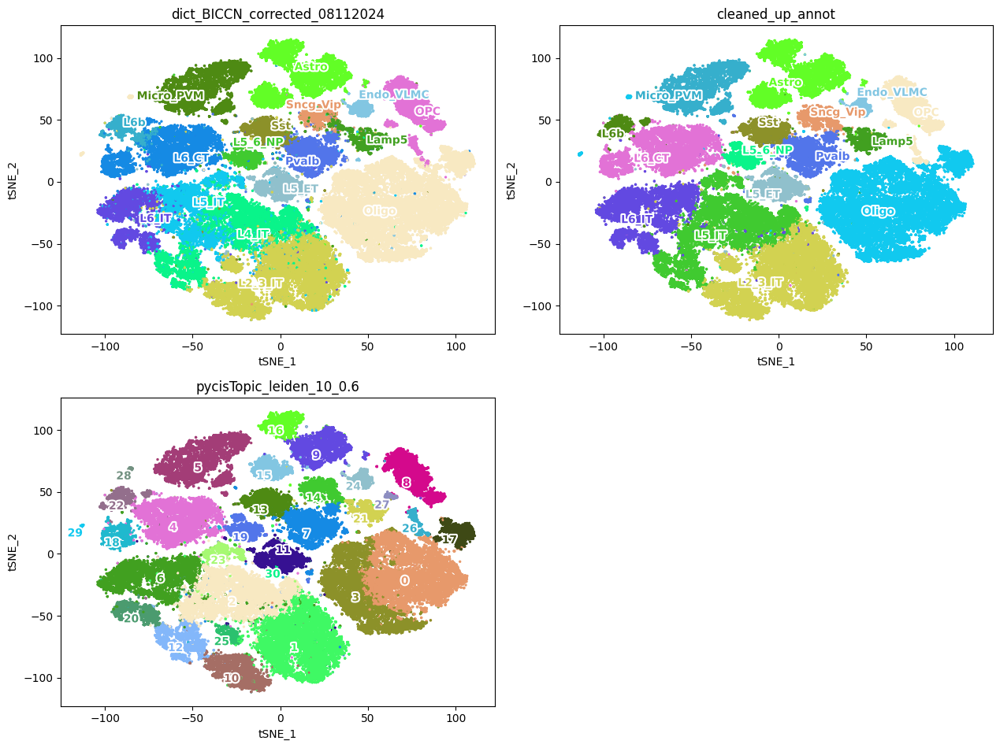

In [63]:
# model 130
plot_metadata(
    cistopic_obj,
    reduction_name='tSNE',
    variables=['dict_BICCN_corrected_08112024', 'cleaned_up_annot', 'pycisTopic_leiden_10_0.6'],
    target='cell', num_columns=2,
    text_size=10,
    dot_size=2)

In [65]:
matrix = cistopic_obj.cell_data[['cleaned_up_annot']]
with open(out_dir + '../matrix_barcodes_prelimannot_27022024.pkl', 'wb') as f:
  pickle.dump(matrix, f)

# make bws for CREsted with scATAC tool

In [12]:
#after models - models are submitted
# Load cisTopic object
import pickle
infile = open(out_dir + 'cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025_130topics.pkl', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

In [13]:
cistopic_obj.cell_data.columns

Index(['Unique_nr_frag', 'Total_nr_frag_in_regions', 'beads', 'barcode',
       'cisTopic_log_nr_acc', 'Dupl_nr_frag',
       'preliminary_mouse_annot_23072024', 'pycisTopic_leiden_10_0.6',
       'tech_simple', 'pycisTopic_leiden_10_2', 'sample_prep',
       'Zu_paper_lift_over_simple', 'FRIP',
       'kde__log_Unique_nr_frag_in_regions__TSS_enrichment',
       'Unique_nr_frag_in_regions', 'Dupl_rate', 'refined_annot',
       'refined_annot_simple', 'kde__log_Unique_nr_frag_in_regions__Dupl_rate',
       'cisTopic_log_nr_frag', 'pycisTopic_leiden_10_1.2', 'cisTopic_nr_frag',
       'dict_BICCN_corrected_08112024', 'region_label',
       'Doublet_scores_fragments', 'Zu_paper_lift_over',
       'kde__log_Unique_nr_frag_in_regions__FRIP', 'cisTopic_nr_acc',
       'sample_id', 'techxZu_paper_lift_over_simple', 'tech', 'TSS_enrichment',
       'Predicted_doublets_fragments', 'Total_nr_frag', 'Log_unique_nr_frag',
       'Log_total_nr_frag', 'pycisTopic_leiden_10_2.5', 'cleaned_up_annot'],

In [16]:
import pandas as pd

# 1. Filter to cells assigned in `cleaned_up_annot_tech`
df = cistopic_obj.cell_data[
    cistopic_obj.cell_data['cleaned_up_annot_tech'].notna()
].copy()

# 2. Split `cleaned_up_annot_tech` into tech and annotation
tech_and_annot = df['cleaned_up_annot_tech'].str.split('___', n=1, expand=True)
df['tech_simple'] = tech_and_annot[1]
df['annotation']  = tech_and_annot[0]
df['cell_type']   = df['cleaned_up_annot_tech']  # final label

# 3. Compute counts per annotation × tech
counts = (
    df
    .groupby(['annotation', 'tech_simple'])
    .size()
    .unstack(fill_value=0)
)

# 4. Verify that 10x is always the limiting factor
mask = counts['10x'] <= counts['HyDrop_v2']
if not mask.all():
    bad = counts.loc[~mask, ['10x', 'HyDrop_v2']]
    print("Warning: for these cell types, 10x exceeds HyDrop_v2 and will be used as limiter anyway:")
    print(bad)

In [17]:
# 4. Determine, for each annotation, which tech is limiting
limiters = counts.apply(lambda row: 
                        '10x' if row['10x'] <= row['HyDrop_v2'] else 'HyDrop_v2', 
                        axis=1)
limit_table = pd.DataFrame({
    '10x_count':     counts['10x'],
    'HyDrop_v2_count': counts['HyDrop_v2'],
    'limiting_tech': limiters
})
print("Per-cell-type counts and limiting technology:")
print(limit_table)

# 5. Sample down to the true minimum for each annotation
sampled = []
for annot, row in counts.iterrows():
    # find the minimum count
    n = min(row['10x'], row['HyDrop_v2'])
    for tech in ['10x', 'HyDrop_v2']:
        subset = df[
            (df['annotation'] == annot) &
            (df['tech_simple']  == tech)
        ]
        # If for some reason a tech is missing or has fewer cells than n, sample what's available
        actual_n = min(n, len(subset))
        sampled.append(
            subset.sample(n=actual_n, random_state=42, replace=False)
        )

# 6. Concatenate and format output
sampled_df = pd.concat(sampled, ignore_index=True)
sampled_df = (
    sampled_df
    .rename(columns={'sample_id': 'sample', 'barcode': 'cell_barcode'})
    [['sample', 'cell_type', 'cell_barcode']]
)

# 7. Write to TSV
output_tsv = (
    "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/"
    "cistopic/bw_files/cell_types_to_cell_barcode_limited_cellnumber.tsv"
)
sampled_df.to_csv(output_tsv, sep='\t', index=False)

print(f"\nBalanced sampling complete. Output saved to {output_tsv}")

Per-cell-type counts and limiting technology:
            10x_count  HyDrop_v2_count limiting_tech
annotation                                          
Astro            2095             3807           10x
Endo_VLMC         424              484           10x
L2_3_IT          3189             9586           10x
L5_6_NP           280             1156           10x
L5_ET             523             2131           10x
L5_IT            2814             8631           10x
L6_CT            1643             5780           10x
L6_IT            1563             5453           10x
L6b               128             1041           10x
Lamp5             279             1121           10x
Micro_PVM        1030             4229           10x
OPC               911             2929           10x
Oligo            3287            14550           10x
Pvalb             580             3074           10x
Sncg_Vip          368             1326           10x
Sst               364             1782           10x


## full amount of cells

First, we subset the cistopic obj to only contain the 10x and HyDrop v2 cells. We leave out HyDrop v1 as there are a limited number of cells and we do not want to train a model on this.

In [66]:
annot_counts = cistopic_obj.cell_data['tech_simple'].value_counts().to_dict()
print(annot_counts)

{'HyDrop_v2': 67080, '10x_v1': 9756, '10x_v2': 9722, 'HyDrop_v1': 5805}


In [6]:
tech_general_dict= {'HyDrop_v2': 'HyDrop_v2', '10x_v1': '10x', '10x_v2': '10x', 'HyDrop_v1': 'HyDrop_v1'}

In [7]:
for number, new_value in tech_general_dict.items():
    cistopic_obj.cell_data.loc[
        cistopic_obj.cell_data["tech_simple"] == number, "tech_general"] = new_value

In [69]:
annot_counts = cistopic_obj.cell_data['tech_general'].value_counts().to_dict()
print(annot_counts)

{'HyDrop_v2': 67080, '10x': 19478, 'HyDrop_v1': 5805}


In [8]:
conditions = ['HyDrop_v1']

# Filter the cells based on pycisTopic_leiden_10_0.6 to exclude the conditions
filtered_cells = cistopic_obj.cell_data[~cistopic_obj.cell_data['tech_general'].isin(conditions)]

# Get the list of cell IDs from the filtered DataFrame
cell_ids_list = filtered_cells.index.tolist()

# Create a new cistopic object with the excluded cells
new_object_atlas = cistopic_obj.subset(cell_ids_list, copy=True)


In [9]:
annot_counts = new_object_atlas.cell_data['tech_general'].value_counts().to_dict()
print(annot_counts)

{'HyDrop_v2': 67080, '10x': 19478}


In [10]:
cistopic_obj = new_object_atlas

In [11]:
cistopic_obj.cell_data['cleaned_up_annot_tech'] = cistopic_obj.cell_data['cleaned_up_annot'].astype(str) + '___' + cistopic_obj.cell_data['tech_general'].astype(str)

In [12]:
annot_counts = cistopic_obj.cell_data['cleaned_up_annot_tech'].value_counts().to_dict()
print(annot_counts)

{'Oligo___HyDrop_v2': 14550, 'L2_3_IT___HyDrop_v2': 9586, 'L5_IT___HyDrop_v2': 8631, 'L6_CT___HyDrop_v2': 5780, 'L6_IT___HyDrop_v2': 5453, 'Micro_PVM___HyDrop_v2': 4229, 'Astro___HyDrop_v2': 3807, 'Oligo___10x': 3287, 'L2_3_IT___10x': 3189, 'Pvalb___HyDrop_v2': 3074, 'OPC___HyDrop_v2': 2929, 'L5_IT___10x': 2814, 'L5_ET___HyDrop_v2': 2131, 'Astro___10x': 2095, 'Sst___HyDrop_v2': 1782, 'L6_CT___10x': 1643, 'L6_IT___10x': 1563, 'Sncg_Vip___HyDrop_v2': 1326, 'L5_6_NP___HyDrop_v2': 1156, 'Lamp5___HyDrop_v2': 1121, 'L6b___HyDrop_v2': 1041, 'Micro_PVM___10x': 1030, 'OPC___10x': 911, 'Pvalb___10x': 580, 'L5_ET___10x': 523, 'Endo_VLMC___HyDrop_v2': 484, 'Endo_VLMC___10x': 424, 'Sncg_Vip___10x': 368, 'Sst___10x': 364, 'L5_6_NP___10x': 280, 'Lamp5___10x': 279, 'L6b___10x': 128}


### scATAC tools for bws

We use https://aertslab.github.io/scatac_fragment_tools/split.html for generating bws to use in CREsted.

1. make sample_to_fragments.tsv file

In [75]:
import pandas as pd

# Access the dictionary from cistopic_obj
fragments_dict = cistopic_obj.path_to_fragments

# Convert the dictionary to a pandas DataFrame
fragments_df = pd.DataFrame(list(fragments_dict.items()), columns=['sample', 'path_to_fragment_file'])

# Define the output TSV file path
output_tsv_path = "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/sample_to_fragments.tsv"

# Save the DataFrame to a TSV file
fragments_df.to_csv(output_tsv_path, sep='\t', index=False)

print(f"Dictionary saved to {output_tsv_path}")

Dictionary saved to /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/sample_to_fragments.tsv


2. celltypes_to_cellbarcode.tsv file

In [76]:
import pandas as pd

# 1. Assume `cleaned_up_annot_tech` is already a column on cell_data
#    containing strings like "tech_simple___celltype" for every cell you want.

# 2. Filter: keep all rows where cleaned_up_annot_tech is not null
filtered = cistopic_obj.cell_data[
    cistopic_obj.cell_data['cleaned_up_annot_tech'].notna()
].copy()

# 3. Rename columns for clarity/output
filtered.rename(
    columns={
        'sample_id': 'sample',
        'barcode': 'cell_barcode',
        'cleaned_up_annot_tech': 'cell_type'
    },
    inplace=True
)

# 4. Select only the three columns we need
out = filtered[['sample', 'cell_type', 'cell_barcode']]

# 5. Write to TSV
output_tsv_path = (
    "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/"
    "cell_types_to_cell_barcode.tsv"
)
out.to_csv(output_tsv_path, sep='\t', index=False)

print(f"All cells in 'cleaned_up_annot_tech' written to {output_tsv_path}")


All cells in 'cleaned_up_annot_tech' written to /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/cell_types_to_cell_barcode.tsv


3. run sc toolkit

``running in tmux sctoolkit on s28l08``

## downsampled to number of 10x cells per cell type

1. Here we can use the same sample_to_fragment.tsv file but have to redo the cell_types_to_cell_barcode.tsv as we ony want to include the same amount of HyDrop as 10x cells for the bws. 

2. 

In [82]:
import pandas as pd

# 1. Filter to cells assigned in `cleaned_up_annot_tech`
df = cistopic_obj.cell_data[
    cistopic_obj.cell_data['cleaned_up_annot_tech'].notna()
].copy()

# 2. Split `cleaned_up_annot_tech` into tech and annotation
tech_and_annot = df['cleaned_up_annot_tech'].str.split('___', n=1, expand=True)
df['tech_simple'] = tech_and_annot[1]
df['annotation']  = tech_and_annot[0]
df['cell_type']   = df['cleaned_up_annot_tech']  # final label

# 3. Compute counts per annotation × tech
counts = (
    df
    .groupby(['annotation', 'tech_simple'])
    .size()
    .unstack(fill_value=0)
)

# 4. Verify that 10x is always the limiting factor
mask = counts['10x'] <= counts['HyDrop_v2']
if not mask.all():
    bad = counts.loc[~mask, ['10x', 'HyDrop_v2']]
    print("Warning: for these cell types, 10x exceeds HyDrop_v2 and will be used as limiter anyway:")
    print(bad)

In [84]:
# 5. Sample each annotation down to the 10x count
sampled = []
for annot, row in counts.iterrows():
    if {'10x', 'HyDrop_v2'}.issubset(row.index):
        n = row['10x']  # enforce 10x as limiter
        for tech in ['10x', 'HyDrop_v2']:
            subset = df[
                (df['annotation'] == annot) &
                (df['tech_simple']  == tech)
            ]
            sampled.append(
                subset.sample(n=min(n, len(subset)),
                              random_state=42,
                              replace=False)
            )

# 6. Concatenate and prepare output
sampled_df = pd.concat(sampled, ignore_index=True)
sampled_df = sampled_df.rename(
    columns={'sample_id': 'sample', 'barcode': 'cell_barcode'}
)[['sample', 'cell_type', 'cell_barcode']]

# 7. Write to TSV
output_tsv = (
    "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/"
    "cell_types_to_cell_barcode_limited_cellnumber.tsv")

sampled_df.to_csv(output_tsv, sep='\t', index=False)
print(f"Balanced sampling complete. Output saved to {output_tsv}")


Balanced sampling complete. Output saved to /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/cell_types_to_cell_barcode_limited_cellnumber.tsv


3. run sc toolkit

``running in tmux sctoolkit_2 on s28l08``

## downsamples # cells HyDrop 

In [4]:
#after models - models are submitted
# Load cisTopic object
import pickle
infile = open(out_dir + 'cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025_130topics.pkl', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

In [5]:
out_dir

'/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/'

In [6]:
tech_general_dict= {'HyDrop_v2': 'HyDrop_v2', '10x_v1': '10x', '10x_v2': '10x', 'HyDrop_v1': 'HyDrop_v1'}

In [7]:
for number, new_value in tech_general_dict.items():
    cistopic_obj.cell_data.loc[
        cistopic_obj.cell_data["tech_simple"] == number, "tech_general"] = new_value

In [69]:
annot_counts = cistopic_obj.cell_data['tech_general'].value_counts().to_dict()
print(annot_counts)

{'HyDrop_v2': 67080, '10x': 19478, 'HyDrop_v1': 5805}


In [8]:
conditions = ['HyDrop_v1']

# Filter the cells based on pycisTopic_leiden_10_0.6 to exclude the conditions
filtered_cells = cistopic_obj.cell_data[~cistopic_obj.cell_data['tech_general'].isin(conditions)]

# Get the list of cell IDs from the filtered DataFrame
cell_ids_list = filtered_cells.index.tolist()

# Create a new cistopic object with the excluded cells
new_object_atlas = cistopic_obj.subset(cell_ids_list, copy=True)


In [9]:
annot_counts = new_object_atlas.cell_data['tech_general'].value_counts().to_dict()
print(annot_counts)

{'HyDrop_v2': 67080, '10x': 19478}


In [10]:
cistopic_obj = new_object_atlas

In [11]:
cistopic_obj.cell_data['cleaned_up_annot_tech'] = cistopic_obj.cell_data['cleaned_up_annot'].astype(str) + '___' + cistopic_obj.cell_data['tech_general'].astype(str)

In [12]:
annot_counts = cistopic_obj.cell_data['cleaned_up_annot_tech'].value_counts().to_dict()
print(annot_counts)

{'Oligo___HyDrop_v2': 14550, 'L2_3_IT___HyDrop_v2': 9586, 'L5_IT___HyDrop_v2': 8631, 'L6_CT___HyDrop_v2': 5780, 'L6_IT___HyDrop_v2': 5453, 'Micro_PVM___HyDrop_v2': 4229, 'Astro___HyDrop_v2': 3807, 'Oligo___10x': 3287, 'L2_3_IT___10x': 3189, 'Pvalb___HyDrop_v2': 3074, 'OPC___HyDrop_v2': 2929, 'L5_IT___10x': 2814, 'L5_ET___HyDrop_v2': 2131, 'Astro___10x': 2095, 'Sst___HyDrop_v2': 1782, 'L6_CT___10x': 1643, 'L6_IT___10x': 1563, 'Sncg_Vip___HyDrop_v2': 1326, 'L5_6_NP___HyDrop_v2': 1156, 'Lamp5___HyDrop_v2': 1121, 'L6b___HyDrop_v2': 1041, 'Micro_PVM___10x': 1030, 'OPC___10x': 911, 'Pvalb___10x': 580, 'L5_ET___10x': 523, 'Endo_VLMC___HyDrop_v2': 484, 'Endo_VLMC___10x': 424, 'Sncg_Vip___10x': 368, 'Sst___10x': 364, 'L5_6_NP___10x': 280, 'Lamp5___10x': 279, 'L6b___10x': 128}


1. make new sample_to_fragment.tsv file with only HyDrop v2 cells

In [25]:
# fragment tsv file
import pandas as pd
from pathlib import Path

# 1. Load and annotate your metadata
df = cistopic_obj.cell_data[
    cistopic_obj.cell_data['cleaned_up_annot_tech'].notna()
].copy()
tech_and_annot = df['cleaned_up_annot_tech'].str.split('___', n=1, expand=True)
df['annotation'] = tech_and_annot[0]
df['tech_simple'] = tech_and_annot[1]

# 2. Get the set of HyDrop_v2 sample names
hydrop_samples = set(df.loc[df['tech_simple']=='HyDrop_v2', 'sample_id'])

# 3. Build the fragments DataFrame and filter by HyDrop_v2
fragments_dict = cistopic_obj.path_to_fragments
fragments_df = (
    pd.DataFrame.from_dict(fragments_dict, orient='index', columns=['path_to_fragment_file'])
      .rename_axis('sample')
      .reset_index()
      .query("sample in @hydrop_samples")
)

# 4. Write out the TSV
output_tsv = Path(
    "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/sample_to_fragments_HyDrop.tsv"
)
fragments_df.to_csv(output_tsv, sep='\t', index=False)
print(f"Written {len(fragments_df)} HyDrop_v2 entries to {output_tsv}")


Written 35 HyDrop_v2 entries to /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/sample_to_fragments_HyDrop.tsv


2. code to filter the cells to make different cell_tyoes_to_cell_barcodes.tsv to only inlcude smaller amount of Hydrop cells

In [24]:
import pandas as pd
import math
from pathlib import Path

# 1. Load your annotated metadata
df = cistopic_obj.cell_data[
    cistopic_obj.cell_data['cleaned_up_annot_tech'].notna()
].copy()
tech_and_annot = df['cleaned_up_annot_tech'].str.split('___', n=1, expand=True)
df['annotation'] = tech_and_annot[0]
df['tech_simple'] = tech_and_annot[1]

# 2. Compute counts per annotation for 10x and HyDrop_v2
ct_10x = df[df['tech_simple']=='10x'].groupby('annotation').size().rename('n10x')
ct_hy = df[df['tech_simple']=='HyDrop_v2'].groupby('annotation').size().rename('nHydropTotal')
counts = pd.concat([ct_10x, ct_hy], axis=1).fillna(0).astype(int)

# 3. Define the fractions of the *remaining* HyDrop cells to add
factors = {
    'baseline': 0.00,   # no extra beyond n10x
    'plus25':    0.25,  # +25% of the remainder
    'plus50':    0.50,
    'plus75':    0.75,
}

out_dir = Path("/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files")
out_dir.mkdir(parents=True, exist_ok=True)

# 4. Perform sampling for each factor
for name, frac in factors.items():
    all_samples = []
    for annot, row in counts.iterrows():
        n10x = row['n10x']
        nHyd = row['nHydropTotal']
        if nHyd == 0 or n10x == 0:
            continue

        pool = df[(df['annotation']==annot) & (df['tech_simple']=='HyDrop_v2')]

        # 4a) baseline draw
        baseline = pool.sample(n=n10x, random_state=42, replace=False)

        if name == 'baseline':
            chosen = baseline
        else:
            # 4b) draw extras from the remainder
            remainder = pool.drop(index=baseline.index)
            nExtra = math.floor((nHyd - n10x) * frac)
            extras = remainder.sample(n=min(nExtra, len(remainder)),
                                     random_state=42, replace=False)
            chosen = pd.concat([baseline, extras], ignore_index=True)

        all_samples.append(chosen)

    # 5. Concatenate all annotations for this factor
    samp_df = pd.concat(all_samples, ignore_index=True)

    # 6. Rename columns for clarity/output
    samp_df.rename(
        columns={
            'sample_id': 'sample',
            'barcode': 'cell_barcode',
            'cleaned_up_annot_tech': 'cell_type'
        },
        inplace=True
    )

    # 7. Select only the three columns we need
    out_df = samp_df[['sample', 'cell_type', 'cell_barcode']]

    # 8. Write the TSV
    out_file = out_dir / f"celltypes_HyDrop_sampling_{name}.tsv"
    out_df.to_csv(out_file, sep='\t', index=False)

    print(f"Written {out_file}  (added {int(frac*100)}% of remainder)")


Written /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/celltypes_HyDrop_sampling_baseline.tsv  (added 0% of remainder)
Written /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/celltypes_HyDrop_sampling_plus25.tsv  (added 25% of remainder)
Written /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/celltypes_HyDrop_sampling_plus50.tsv  (added 50% of remainder)
Written /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/celltypes_HyDrop_sampling_plus75.tsv  (added 75% of remainder)


3. run sc toolkit to make bws

In [ ]:
conda activate sc_toolkit
# Define the path to the chromosome sizes file
chrom_sizes=/lustre1/project/stg_00002/lcb/hdickm/resources/mouse/mm10_chrom_sizes_ucsc_06082924.fa.fai

In [ ]:
#!/bin/bash
outdir=
# Define your list of TSVs either as a Bash array...
tsv_list=(
  "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/celltypes_HyDrop_sampling_plus75.tsv"
  "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/celltypes_HyDrop_sampling_plus25.tsv"
  "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/bw_files/celltypes_HyDrop_sampling_plus50.tsv"
)

for tsv in "${tsv_list[@]}"; do
  # Derive an output directory based on the TSV name
  outdir="${tsv%.tsv}"
  mkdir -p "$outdir/bws"
  
  echo "Splitting fragments for $tsv into $outdir"
  scatac_fragment_tools split \
    -f sample_to_fragments_HyDrop.tsv \
    -b "$tsv" \
    -c "/lustre1/project/stg_00002/lcb/hdickm/resources/mouse/mm10_chrom_sizes_ucsc_06082924.fa.fai" \
    -o "$outdir"

  # Generate BigWigs for each fragment file
  for frag in "$outdir"/*.tsv.gz; do
    base=$(basename "$frag" .tsv.gz)
    bw="$outdir/bws/${base}.bw"
    echo "  -> $bw"
    scatac_fragment_tools bigwig \
      -i "$frag" \
      -c "/lustre1/project/stg_00002/lcb/hdickm/resources/mouse/mm10_chrom_sizes_ucsc_06082924.fa.fai" \
      -o "$bw" \
      --normalize
  done
done

echo "All requested TSVs processed."


# make consensus peaks for CREsted using all data

In [4]:
#after models - models are submitted
# Load cisTopic object
import pickle
infile = open(out_dir + 'cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025_130topics.pkl', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

2025-06-11 17:37:10,302	INFO util.py:154 -- Missing packages: ['ipywidgets']. Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.


In [86]:
fragments_dict = {'HYA__76b206__20240430_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__76b206__20240430_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'atac_v1_adult_brain_fresh_5k': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/atac_v1_adult_brain_fresh_5k.fragments.tsv.gz',
 'HYA__ba8433__20231116_HyATAC_MouseCortex_B2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__ba8433__20231116_HyATAC_MouseCortex_B2.fragments.tsv.gz',
 'HYA__177788__20240117_Mouse_Cortex-d-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__177788__20240117_Mouse_Cortex-d-ATAC.fragments.tsv.gz',
 'HYA__67df33__20240105_Mouse_Cortex-d-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__67df33__20240105_Mouse_Cortex-d-ATAC.fragments.tsv.gz',
 'HYA__b606e2__20240117_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__b606e2__20240117_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'HYA__e9082f__20240430_Mouse_Cortex-d-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__e9082f__20240430_Mouse_Cortex-d-ATAC.fragments.tsv.gz',
 'HYA__e1bdab__20230829_mouse_cortex_2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__e1bdab__20230829_mouse_cortex_2.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-5': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2.fragments.tsv.gz',
 'HYA__955707__20240304_Mouse_Cortex-b2-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__955707__20240304_Mouse_Cortex-b2-ATAC.fragments.tsv.gz',
 'HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-4': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4.fragments.tsv.gz',
'HYA__7ad445__20231031_HyDropAtac_MouseCortex_A1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__7ad445__20231031_HyDropAtac_MouseCortex_A1.fragments.tsv.gz',
 'HYA__853a40__20240304_Mouse_Cortex-b1-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__853a40__20240304_Mouse_Cortex-b1-ATAC.fragments.tsv.gz',
 'HYA__fcb55f__20231013_HyDropATAC_MouseCortex_B': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__fcb55f__20231013_HyDropATAC_MouseCortex_B.fragments.tsv.gz',
 'HYA__ac683b__20230829_mouse_cortex_1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__ac683b__20230829_mouse_cortex_1.fragments.tsv.gz',
 'HYA__14fb45__20231013_HyDropATAC_MouseCortex_D': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__14fb45__20231013_HyDropATAC_MouseCortex_D.fragments.tsv.gz',
 'HYA__30fc7f__20231031_HyDropAtac_MouseCortex_D1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__30fc7f__20231031_HyDropAtac_MouseCortex_D1.fragments.tsv.gz',
 'HYA__3eb2c7__20240221_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__3eb2c7__20240221_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__831196__20240105_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__831196__20240105_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'HYA__8d1d23__20231116_HyATAC_MouseCortex_C1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__8d1d23__20231116_HyATAC_MouseCortex_C1.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-3': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-3.fragments.tsv.gz',
 'HYA__cc24b7__20240304_Mouse_Cortex-c-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__cc24b7__20240304_Mouse_Cortex-c-ATAC.fragments.tsv.gz',
 '8k_mouse_cortex_ATACv2_nextgem_Chromium_Controller': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/8k_mouse_cortex_ATACv2_nextgem_Chromium_Controller.fragments.tsv.gz',
 'HYA__a7a748__20231031_HyDropAtac_MouseCortex_C2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__a7a748__20231031_HyDropAtac_MouseCortex_C2.fragments.tsv.gz',
 'HYA__167ec9__20240304_Mouse_Cortex-a2-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__167ec9__20240304_Mouse_Cortex-a2-ATAC.fragments.tsv.gz',
'HYA__247495__20231013_HyDropATAC_MouseCortex_C': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__247495__20231013_HyDropATAC_MouseCortex_C.fragments.tsv.gz',
 'HYA__87f862__20240117_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__87f862__20240117_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__7e2d51__20231031_HyDropAtac_MouseCortex_B1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__7e2d51__20231031_HyDropAtac_MouseCortex_B1.fragments.tsv.gz',
 'HYA__00c24b__20240117_Mouse_Cortex-c-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__00c24b__20240117_Mouse_Cortex-c-ATAC.fragments.tsv.gz',
 'HYA__fd6250__20240105_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__fd6250__20240105_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__c0d7e5__20240304_Mouse_Cortex-a1-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__c0d7e5__20240304_Mouse_Cortex-a1-ATAC.fragments.tsv.gz',
 'HYA__3e5c73__20231031_HyDropAtac_MouseCortex_D2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__3e5c73__20231031_HyDropAtac_MouseCortex_D2.fragments.tsv.gz',
 'HYA__9667aa__20231116_HyATAC_MouseCortex_C2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__9667aa__20231116_HyATAC_MouseCortex_C2.fragments.tsv.gz',
 'HYA__66fdea__20231116_HyATAC_MouseCortex_B1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__66fdea__20231116_HyATAC_MouseCortex_B1.fragments.tsv.gz',
 'HYA__2eb25d__20240430_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__2eb25d__20240430_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__21de27__20240105_Mouse_Cortex-c-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__21de27__20240105_Mouse_Cortex-c-ATAC.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1.fragments.tsv.gz',
 'HYA__d4ff32__20231116_HyATAC_MouseCortex_A': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__d4ff32__20231116_HyATAC_MouseCortex_A.fragments.tsv.gz',
 'HYA__6b44d3__20240221_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__6b44d3__20240221_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'HYA__7a1cc3__20231013_HyDropATAC_MouseCortex_A': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__7a1cc3__20231013_HyDropATAC_MouseCortex_A.fragments.tsv.gz',
 'HYA__0f6aa5__20231031_HyDropAtac_MouseCortex_B2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__0f6aa5__20231031_HyDropAtac_MouseCortex_B2.fragments.tsv.gz',
 '8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X.fragments.tsv.gz'}

In [16]:
import pandas as pd
chromsizes = pd.read_table(
    "http://hgdownload.cse.ucsc.edu/goldenPath/mm10/bigZips/mm10.chrom.sizes",
    header = None,
    names = ["Chromosome", "End"]
)
chromsizes.insert(1, "Start", 0)
chromsizes.head()

,Chromosome,Start,End
0,chr1,0,195471971
1,chr2,0,182113224
2,chrX,0,171031299
3,chr3,0,160039680
4,chr4,0,156508116


In [88]:
tmp_dir = '/scratch/leuven/350/vsc35050/'

In [93]:
from pycisTopic.pseudobulk_peak_calling import *
bw_paths, bed_paths = export_pseudobulk(input_data = cistopic_obj.cell_data,
                 variable = 'cleaned_up_annot',
                 sample_id_col = 'sample_id',
                 chromsizes = chromsizes,
                 bed_path = out_dir + 'pseudobulk/cleaned_up_annot/pseudobulk_bed_files/',
                 bigwig_path = out_dir + 'pseudobulk/cleaned_up_annot/pseudobulk_bw_files/',
                 path_to_fragments = fragments_dict,
                 n_cpu = 20,
                 normalize_bigwig = True,
                 #remove_duplicates = True,
                 temp_dir = tmp_dir + 'ray_spill',
                 split_pattern = '___')

2025-06-11 16:55:33,240 cisTopic     INFO     Splitting fragments by cell type.


[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__76b206__20240430_Mouse_Cortex-a-ATAC.fragments.tsv.gz.tbi
[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__ba8433__20231116_HyATAC_MouseCortex_B2.fragments.tsv.gz.tbi
[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1.fragments.tsv.gz.tbi
[W::hts_idx_load3] [W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/atac_v1_adult_brain_fresh_5k.fragments.tsv.gz.tbiThe index file is older than the data file: /lustre1/projec

2025-06-11 17:01:31,522 cisTopic     INFO     generating bigwig files


In [108]:
import pickle
with open(out_dir +'pseudobulk/cleaned_up_annot/pseudobulk_bed_files/bed_paths.pkl', 'wb') as f:
  pickle.dump(bed_paths, f)
with open(out_dir + 'pseudobulk/cleaned_up_annot/pseudobulk_bw_files/bw_paths.pkl', 'wb') as f:
  pickle.dump(bw_paths, f)

In [5]:
import pickle
infile = open(out_dir +'pseudobulk/cleaned_up_annot/pseudobulk_bed_files/bed_paths.pkl', 'rb')
bed_paths = pickle.load(infile)
infile.close()

In [13]:
from pycisTopic.pseudobulk_peak_calling import peak_calling
macs_path = "macs2"

In [7]:
import ray
ray.shutdown()
ray.init(num_cpus = 1, _temp_dir = '/scratch/leuven/350/vsc35050/consensus') #to solve the ray error


2025-06-11 17:37:26,712	INFO worker.py:1724 -- Started a local Ray instance.


Python version:,3.11.8
Ray version:,2.9.3


In [8]:
ray.__version__

'2.9.3'

In [9]:
ray.shutdown()

In [10]:
!export PYTHONIOENCODING=UTF-8

In [11]:
ray.shutdown()
import ray
ray.init(num_cpus = 1)
ray.shutdown()


2025-06-11 17:37:41,157	INFO worker.py:1724 -- Started a local Ray instance.


In [14]:
narrow_peak_dict = peak_calling(
    macs_path = macs_path,
    bed_paths = bed_paths,
    outdir = out_dir + "MACS",
    genome_size = 'mm',
   n_cpu = 1,
    input_format = 'BEDPE',
    shift = 73,
    ext_size = 146,
    keep_dup = 'all',
    q_value = 0.05,
    skip_empty_peaks = True, #new to avoid ray error, in pycistopic dev env: staging/leuven/stg_00002/lcb/sdewin/PhD/python_modules/sing_image_pycistopic_pseudobulk_update/pycistopic_20240222.sif
    #_temp_dir = '/scratch/leuven/350/vsc35050/ray_spill'
)

2025-06-11 17:39:24,239 cisTopic     INFO     Calling peaks for Oligo with macs2 callpeak --treatment /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/pseudobulk/cleaned_up_annot/pseudobulk_bed_files/Oligo.fragments.tsv.gz --name Oligo  --outdir /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/MACS --format BEDPE --gsize mm --qvalue 0.05 --nomodel --shift 73 --extsize 146 --keep-dup all --call-summits --nolambda
2025-06-11 17:45:13,088 cisTopic     INFO     Oligo done!
2025-06-11 17:45:13,089 cisTopic     INFO     Calling peaks for L6_CT with macs2 callpeak --treatment /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/pseudobulk/cleaned_up_annot/pseudobulk_bed_files/L6_CT.fragments.tsv.gz --name L6_CT  --outdir /lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/MACS --format BEDPE --gsize mm --qvalue 0.05 --nomodel --shift 73 --extsize 146 --keep-dup all --call-summits --nolambda
2025-06-11 17:

In [17]:
from pycisTopic.iterative_peak_calling import get_consensus_peaks
# Other param
peak_half_width=250
path_to_blacklist="/lustre1/project/stg_00002/lcb/hdickm/resources/mouse/mm10-blacklist.v2.bed"
# Get consensus peaks
consensus_peaks = get_consensus_peaks(
    narrow_peaks_dict = narrow_peak_dict,
    peak_half_width = peak_half_width,
    chromsizes = chromsizes,
    path_to_blacklist = path_to_blacklist)

2025-06-11 18:47:10,965 cisTopic     INFO     Extending and merging peaks per class
2025-06-11 18:52:47,588 cisTopic     INFO     Normalizing peak scores
2025-06-11 18:52:48,906 cisTopic     INFO     Merging peaks
Warning! Start and End columns now have different dtypes: int64 and int32
2025-06-11 18:55:04,213 cisTopic     INFO     Done!


In [19]:
consensus_peaks

,Chromosome,Start,End,Name,Score
0,chr1,3094286,3094786,Pvalb_peak_1a,1.467752
1,chr1,3097001,3097501,"Sst_peak_2,Sst_peak_3",2.596229
2,chr1,3097804,3098304,Endo_VLMC_peak_1,2.198511
3,chr1,3112437,3112937,Lamp5_peak_2,1.698854
4,chr1,3118739,3119239,L5_IT_peak_2a,0.131712
...,...,...,...,...,...
808840,chrY,1050180,1050680,"Sst_peak_178705a,Sst_peak_178705b",1.541511
808841,chrY,872845,873345,"Sst_peak_178703,OPC_peak_148755a,OPC_peak_1487...",2.620507
808842,chrY,1245537,1246037,"Pvalb_peak_203999a,Pvalb_peak_203999b,OPC_peak...",5.359799
808843,chrY,1010312,1010812,"L6b_peak_140053,Sst_peak_178704,Micro_PVM_peak...",6.758307


In [18]:
consensus_peaks.to_bed(
    path = os.path.join(out_dir, "pseudobulk/cleaned_up_annot/consensus_peak_calling/consensus_regions_mouse_cleanup_annot_all_data_fulldepth.bed"),
    keep =True,
    compression = 'infer',
    chain = False)

/opt/venv/lib/python3.11/site-packages/pyranges/out.py:37: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  return pd.concat([outdf, df.get(noncanonical)], axis=1)
/opt/venv/lib/python3.11/site-packages/pyranges/out.py:37: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  return pd.concat([outdf, df.get(noncanonical)], axis=1)
/opt/venv/lib/python3.11/site-packages/pyranges/out.py:37: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  return pd.concat([outdf, df.get(noncanonical)], axis=1)
/opt/venv/lib/python3.11/site-packages/pyranges/out.py:37: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  return pd.concat([outdf, df.get(noncanonical)], axis=1)
/opt/venv/lib/python3.11/site-packages/pyranges/out.py:37: FutureWarning: Passin

# calculate sequencing depth

In [4]:
#after models - models are submitted
# Load cisTopic object
import pickle
infile = open(out_dir + 'cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025_130topics_annot.pkl', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

In [6]:
sample_counts = cistopic_obj.cell_data['sample_id'].value_counts().to_dict()
print(sample_counts)

{'8k_mouse_cortex_ATACv2_nextgem_Chromium_Controller': 6478, '8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X': 6316, 'HYA__6b44d3__20240221_Mouse_Cortex-a-ATAC': 3589, 'atac_v1_adult_brain_fresh_5k': 3440, 'HYA__e9082f__20240430_Mouse_Cortex-d-ATAC': 3244, 'HYA__2eb25d__20240430_Mouse_Cortex-b-ATAC': 3112, 'HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1': 2903, 'HYA__76b206__20240430_Mouse_Cortex-a-ATAC': 2806, 'HYA__cc24b7__20240304_Mouse_Cortex-c-ATAC': 2789, 'HYA__0f6aa5__20231031_HyDropAtac_MouseCortex_B2': 2452, 'HYA__8d1d23__20231116_HyATAC_MouseCortex_C1': 2438, 'HYA__9667aa__20231116_HyATAC_MouseCortex_C2': 2434, 'HYA__3e5c73__20231031_HyDropAtac_MouseCortex_D2': 2420, 'HYA__7a1cc3__20231013_HyDropATAC_MouseCortex_A': 2417, 'HYA__21de27__20240105_Mouse_Cortex-c-ATAC': 2305, 'HYA__fd6250__20240105_Mouse_Cortex-b-ATAC': 2273, 'HYA__fcb55f__20231013_HyDropATAC_MouseCortex_B': 2206, 'HYA__d4ff32__20231116_HyATAC_MouseCortex_A': 2166, 'HYA__30fc7f__20231031_HyDropAtac_MouseCortex_D1':

In [9]:
cistopic_obj.cell_data.columns

Index(['Unique_nr_frag', 'Total_nr_frag_in_regions', 'beads', 'barcode',
       'cisTopic_log_nr_acc', 'Dupl_nr_frag',
       'preliminary_mouse_annot_23072024', 'pycisTopic_leiden_10_0.6',
       'tech_simple', 'pycisTopic_leiden_10_2', 'sample_prep',
       'Zu_paper_lift_over_simple', 'FRIP',
       'kde__log_Unique_nr_frag_in_regions__TSS_enrichment',
       'Unique_nr_frag_in_regions', 'Dupl_rate', 'refined_annot',
       'refined_annot_simple', 'kde__log_Unique_nr_frag_in_regions__Dupl_rate',
       'cisTopic_log_nr_frag', 'pycisTopic_leiden_10_1.2', 'cisTopic_nr_frag',
       'dict_BICCN_corrected_08112024', 'region_label',
       'Doublet_scores_fragments', 'Zu_paper_lift_over',
       'kde__log_Unique_nr_frag_in_regions__FRIP', 'cisTopic_nr_acc',
       'sample_id', 'techxZu_paper_lift_over_simple', 'tech', 'TSS_enrichment',
       'Predicted_doublets_fragments', 'Total_nr_frag', 'Log_unique_nr_frag',
       'Log_total_nr_frag', 'pycisTopic_leiden_10_2.5', 'cleaned_up_annot'],

In [14]:
sample_counts = cistopic_obj.cell_data['tech_simple'].value_counts().to_dict()
print(sample_counts)

{'HyDrop_v2': 67080, '10x_v1': 9756, '10x_v2': 9722, 'HyDrop_v1': 5805}


In [21]:
tech_sample_counts = cistopic_obj.cell_data.groupby('cleaned_up_annot_tech')['sample_id'].nunique()
print(tech_sample_counts)

cleaned_up_annot_tech
10x           4
HyDrop_v1     5
HyDrop_v2    35
Name: sample_id, dtype: int64


In [15]:
cleaned_up_annot_tech_dict = {'HyDrop_v2': 'HyDrop_v2', '10x_v1': '10x', '10x_v2': '10x', 'HyDrop_v1': 'HyDrop_v1'}

In [16]:
for number, new_value in cleaned_up_annot_tech_dict.items():
    cistopic_obj.cell_data.loc[
        cistopic_obj.cell_data["tech_simple"] == number, "cleaned_up_annot_tech"] = new_value

In [17]:
sample_counts = cistopic_obj.cell_data['cleaned_up_annot_tech'].value_counts().to_dict()
print(sample_counts)

{'HyDrop_v2': 67080, '10x': 19478, 'HyDrop_v1': 5805}


In [22]:
cluster_avg = cistopic_obj.cell_data.groupby('cleaned_up_annot_tech')['Unique_nr_frag'].mean()
sorted_clusters = cluster_avg.sort_values()
table = sorted_clusters.reset_index()
table.columns = ['cleaned_up_annot_tech', 'Unique_nr_frag']
print(table)

  cleaned_up_annot_tech  Unique_nr_frag
0             HyDrop_v1     9940.927649
1             HyDrop_v2    11164.859123
2                   10x    24444.134357


In [23]:
cluster_avg = cistopic_obj.cell_data.groupby('cleaned_up_annot_tech')['Unique_nr_frag_in_regions'].mean()
sorted_clusters = cluster_avg.sort_values()
table = sorted_clusters.reset_index()
table.columns = ['cleaned_up_annot_tech', 'Unique_nr_frag_in_regions']
print(table)

  cleaned_up_annot_tech  Unique_nr_frag_in_regions
0             HyDrop_v1                3244.679242
1             HyDrop_v2                5417.869022
2                   10x               12922.018020


In [24]:
cluster_avg = cistopic_obj.cell_data.groupby('cleaned_up_annot_tech')['Total_nr_frag'].mean()
sorted_clusters = cluster_avg.sort_values()
table = sorted_clusters.reset_index()
table.columns = ['cleaned_up_annot_tech', 'Total_nr_frag']
print(table)

  cleaned_up_annot_tech  Total_nr_frag
0             HyDrop_v2   24374.004666
1             HyDrop_v1   28634.659259
2                   10x   40458.092515


In [25]:
cluster_avg = cistopic_obj.cell_data.groupby('cleaned_up_annot_tech')['FRIP'].mean()
sorted_clusters = cluster_avg.sort_values()
table = sorted_clusters.reset_index()
table.columns = ['cleaned_up_annot_tech', 'FRIP']
print(table)

  cleaned_up_annot_tech      FRIP
0             HyDrop_v1  0.350367
1             HyDrop_v2  0.513523
2                   10x  0.545416


In [26]:
# Compute mean, median, and std of FRIP per technology
cluster_stats = cistopic_obj.cell_data.groupby('cleaned_up_annot_tech')['FRIP'].agg(['mean', 'median', 'std'])

# Reset index and rename columns for clarity
table = cluster_stats.reset_index()
table.columns = ['cleaned_up_annot_tech', 'FRIP_mean', 'FRIP_median', 'FRIP_std']

print(table)

  cleaned_up_annot_tech  FRIP_mean  FRIP_median  FRIP_std
0                   10x   0.545416     0.541132  0.099786
1             HyDrop_v1   0.350367     0.352360  0.110891
2             HyDrop_v2   0.513523     0.518704  0.091181


In [19]:
import pickle
pickle.dump(
    cistopic_obj,
    open(os.path.join(out_dir, "cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025_130topics_annot.pkl"), "wb")
)

## load PUMATAC data

In [6]:
import pandas as pd

In [7]:
df = pd.read_csv("sample_values.tsv", sep="\t")

In [8]:
alias_dict = {
    "8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X": "10x_v1.1_chromium_X",
    "8k_mouse_cortex_ATACv2_nextgem_Chromium_Controller": "10x_v2",
    "HYA__0f6aa5__20231031_HyDropAtac_MouseCortex_B2": "v2_10/31_B2",
    "HYA__14fb45__20231013_HyDropATAC_MouseCortex_D": "v2_10/13_D",
    "HYA__247495__20231013_HyDropATAC_MouseCortex_C": "v2_10/13_C",
    "HYA__30fc7f__20231031_HyDropAtac_MouseCortex_D1": "v2_10/31_D1",
    "HYA__3e5c73__20231031_HyDropAtac_MouseCortex_D2": "v2_10/31_D2",
    "HYA__473a8a__20231116_HyATAC_MouseCortex_Ex": "v2_11/16_Ex",
    "HYA__4a4f45__20230815_mouse_cortex_1": "v2_08/15_1",
    "HYA__66fdea__20231116_HyATAC_MouseCortex_B1": "v2_11/16_B1",
    "HYA__7a1cc3__20231013_HyDropATAC_MouseCortex_A": "v2_10/13_A",
    "HYA__7ad445__20231031_HyDropAtac_MouseCortex_A1": "v2_10/31_A1",
    "HYA__7e2d51__20231031_HyDropAtac_MouseCortex_B1": "v2_10/31_B1",
    "HYA__8d1d23__20231116_HyATAC_MouseCortex_C1": "v2_11/16_C1",
    "HYA__9667aa__20231116_HyATAC_MouseCortex_C2": "v2_11/16_C2",
    "HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1": "v2_10/31_C1",
    "HYA__a7a748__20231031_HyDropAtac_MouseCortex_C2": "v2_10/31_C2",
    "HYA__ac683b__20230829_mouse_cortex_1": "v2_08/29_1",
    "HYA__ba8433__20231116_HyATAC_MouseCortex_B2": "v2_11/16_B2",
    "HYA__combined__20210323_cortex_phu_dv_etssb_1-1": "v1_1",
    "HYA__combined__20210323_cortex_phu_dv_etssb_1-2": "v1_2",
    "HYA__combined__20210323_cortex_phu_dv_etssb_1-3": "v1_3",
    "HYA__combined__20210323_cortex_phu_dv_etssb_1-4": "v1_4",
    "HYA__combined__20210323_cortex_phu_dv_etssb_1-5": "v1_5",
    "HYA__d4ff32__20231116_HyATAC_MouseCortex_A": "v2_11/16_A",
    "HYA__e1bdab__20230829_mouse_cortex_2": "v2_08/29_2",
    "HYA__fcb55f__20231013_HyDropATAC_MouseCortex_B": "v2_10/13_B",
    "atac_v1_E18_brain_flash_5k": "10x_v1_flashfrozen_e18",
    "atac_v1_adult_brain_fresh_5k": "10x_v1_fresh_adult",
    "e18_mouse_brain_fresh_5k": "10x_multiome_fresh_e18",
    "HYA__aea458__S3-HyD-10052023": "v2_05/10_1",
    "HYA__b6abd3__S1-HyD-10052023": "v2_05/10_3",
    "HYA__00c24b__20240117_Mouse_Cortex-c-ATAC": "v2_01/17_c",
    "HYA__167ec9__20240304_Mouse_Cortex-a2-ATAC": "v2_03/04_a2",
    "HYA__177788__20240117_Mouse_Cortex-d-ATAC": "v2_01/17_d",
    "HYA__21de27__20240105_Mouse_Cortex-c-ATAC": "v2_01/05_c",
    "HYA__3cd222__S2-HyD-10052023": "v2_05/10_2",
    "HYA__3eb2c7__20240221_Mouse_Cortex-b-ATAC": "v2_02/21_b",
    "HYA__67df33__20240105_Mouse_Cortex-d-ATAC": "v2_01/05_d",
    "HYA__6b44d3__20240221_Mouse_Cortex-a-ATAC": "v2_02/21_a",
    "HYA__831196__20240105_Mouse_Cortex-a-ATAC": "v2_01/05_a",
    "HYA__853a40__20240304_Mouse_Cortex-b1-ATAC": "v2_03/04_b1",
    "HYA__87f862__20240117_Mouse_Cortex-b-ATAC": "v2_01/17_b",
    "HYA__955707__20240304_Mouse_Cortex-b2-ATAC": "v2_03/04_b2",
    "HYA__b606e2__20240117_Mouse_Cortex-a-ATAC": "v2_01/17_a",
    "HYA__c0d7e5__20240304_Mouse_Cortex-a1-ATAC": "v2_03/04_a1",
    "HYA__cc24b7__20240304_Mouse_Cortex-c-ATAC": "v2_03/04_c",
    "HYA__fd6250__20240105_Mouse_Cortex-b-ATAC": "v2_01/05_b",
    "HYA__2eb25d__20240430_Mouse_Cortex-b-ATAC": "v2_04/30_b",
    "HYA__3e4632__20240430_Mouse_Cortex-e-ATAC": "v2_04/30_e",
    "HYA__76b206__20240430_Mouse_Cortex-a-ATAC": "v2_04/30_a",
    "HYA__9f6efc__20240430_Mouse_Cortex-c-ATAC": "v2_04/30_c",
    "HYA__e9082f__20240430_Mouse_Cortex-d-ATAC": "v2_04/30_d",
}

In [9]:
# Reverse the dictionary to map from short name to full real name
reverse_alias_dict = {v: k for k, v in alias_dict.items()}

# Add real name column
df["real_name"] = df["sample"].map(reverse_alias_dict)

df.head()

,sample,value,real_name
0,v2_05/10_1,10.808466,HYA__aea458__S3-HyD-10052023
1,v2_01/05_b,21.234444,HYA__fd6250__20240105_Mouse_Cortex-b-ATAC
2,v2_01/17_d,22.793008,HYA__177788__20240117_Mouse_Cortex-d-ATAC
3,v2_03/04_a2,23.700383,HYA__167ec9__20240304_Mouse_Cortex-a2-ATAC
4,v2_03/04_b2,27.469219,HYA__955707__20240304_Mouse_Cortex-b2-ATAC


In [10]:
# Get most frequent 'cleaned_up_annot_tech' per sample_id
tech_mapping = cistopic_obj.cell_data.groupby("sample_id")["cleaned_up_annot_tech"]\
    .agg(lambda x: x.mode().iloc[0] if not x.mode().empty else None)

# Map to DataFrame
df["cleaned_up_annot_tech"] = df["real_name"].map(tech_mapping)

In [12]:
# Calculate mean and std of 'value' per 'cleaned_up_annot_tech'
tech_stats = df.groupby("cleaned_up_annot_tech")["value"].agg(["mean", "median", "std"]).reset_index()

# Show result
tech_stats

,cleaned_up_annot_tech,mean,median,std
0,10x,58.843688,65.042874,14.922023
1,HyDrop_v1,110.618904,112.848509,14.887706
2,HyDrop_v2,46.001899,45.477908,12.670178


In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

/tmp/ipykernel_2660450/2372097474.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/tmp/ipykernel_2660450/2372097474.py:17: FutureWarning: Use "auto" to set automatic grayscale colors. From v0.14.0, "gray" will default to matplotlib's definition.
  sns.stripplot(


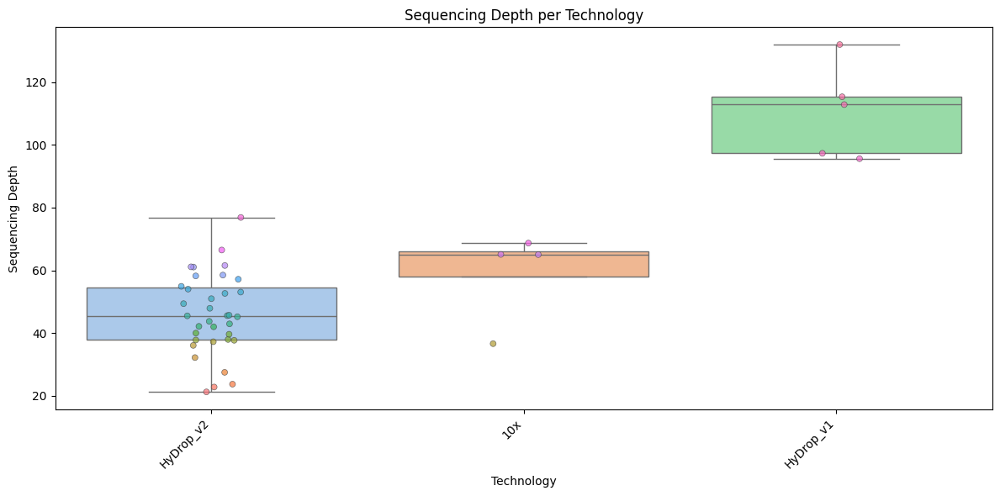

In [17]:
# Sort technologies by mean sequencing depth
tech_order = df.groupby("cleaned_up_annot_tech")["value"].mean().sort_values().index

plt.figure(figsize=(12, 6))

# Boxplot
sns.boxplot(
    x="cleaned_up_annot_tech",
    y="value",
    data=df,
    order=tech_order,
    whis=1.5,
    showfliers=False,
    palette="pastel"
)
# Overlay individual sample points
sns.stripplot(
    x="cleaned_up_annot_tech",
    y="value",
    data=df,
    order=tech_order,
    hue="sample",
    jitter=True,
    alpha=0.7,
    dodge=False,
    size=5,
    edgecolor="gray",
    linewidth=0.5,
    legend=False
)

plt.xticks(rotation=45, ha="right")
plt.ylabel("Sequencing Depth")
plt.xlabel("Technology")
plt.title("Sequencing Depth per Technology")
plt.tight_layout()
plt.show()

# DARs per tech

In [4]:
#after models - models are submitted
# Load cisTopic object
import pickle
infile = open(out_dir + 'cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_09062025_130topics_annot.pkl', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

In [8]:
cistopic_obj.cell_data.columns

Index(['Unique_nr_frag', 'Total_nr_frag_in_regions', 'beads', 'barcode',
       'cisTopic_log_nr_acc', 'Dupl_nr_frag',
       'preliminary_mouse_annot_23072024', 'pycisTopic_leiden_10_0.6',
       'tech_simple', 'pycisTopic_leiden_10_2', 'sample_prep',
       'Zu_paper_lift_over_simple', 'FRIP',
       'kde__log_Unique_nr_frag_in_regions__TSS_enrichment',
       'Unique_nr_frag_in_regions', 'Dupl_rate', 'refined_annot',
       'refined_annot_simple', 'kde__log_Unique_nr_frag_in_regions__Dupl_rate',
       'cisTopic_log_nr_frag', 'pycisTopic_leiden_10_1.2', 'cisTopic_nr_frag',
       'dict_BICCN_corrected_08112024', 'region_label',
       'Doublet_scores_fragments', 'Zu_paper_lift_over',
       'kde__log_Unique_nr_frag_in_regions__FRIP', 'cisTopic_nr_acc',
       'sample_id', 'techxZu_paper_lift_over_simple', 'tech', 'TSS_enrichment',
       'Predicted_doublets_fragments', 'Total_nr_frag', 'Log_unique_nr_frag',
       'Log_total_nr_frag', 'pycisTopic_leiden_10_2.5', 'cleaned_up_annot',


In [5]:
from pycisTopic.diff_features import (
    impute_accessibility,
    normalize_scores,
    find_highly_variable_features,
    find_diff_features
)
import numpy as np

In [6]:
imputed_acc_obj = impute_accessibility(
    cistopic_obj,
    selected_cells=None,
    selected_regions=None,
    scale_factor=10**6
)

2025-07-24 08:56:45,377 cisTopic     INFO     Imputing drop-outs
2025-07-24 08:59:51,786 cisTopic     INFO     Scaling
2025-07-24 09:02:48,390 cisTopic     INFO     Keep non zero rows
2025-07-24 09:06:35,700 cisTopic     INFO     Imputed accessibility sparsity: 0.8050195011441823
2025-07-24 09:06:35,702 cisTopic     INFO     Create CistopicImputedFeatures object
2025-07-24 09:06:35,702 cisTopic     INFO     Making matrix sparse
2025-07-24 09:21:32,385 cisTopic     INFO     Done!


In [7]:
normalized_imputed_acc_obj = normalize_scores(imputed_acc_obj, scale_factor=10**4)

2025-07-24 09:21:33,063 cisTopic     INFO     Normalizing imputed data
2025-07-24 09:32:38,825 cisTopic     INFO     Done!


In [8]:
variable_regions = find_highly_variable_features(
    normalized_imputed_acc_obj,
    min_disp = 0.05,
    min_mean = 0.0125,
    max_mean = 3,
    max_disp = np.inf,
    n_bins=20,
    n_top_features=None,
    plot=False
)

2025-07-24 09:36:27,573 cisTopic     INFO     Done!


<Figure size 640x480 with 0 Axes>

In [9]:
with open(out_dir + 'DARs/variable_regions.pkl', 'wb') as f:
  pickle.dump(variable_regions, f)
with open(out_dir + 'DARs/Imputed_accessibility.pkl', 'wb') as f:
  pickle.dump(imputed_acc_obj, f)

In [10]:
#added later
cistopic_obj.cell_data['techxcleaned_up_annot'] = cistopic_obj.cell_data['cleaned_up_annot_tech'] + '___'+ cistopic_obj.cell_data['cleaned_up_annot']

In [11]:
markers_dict= find_diff_features(
    cistopic_obj,
    imputed_acc_obj,
    variable='techxcleaned_up_annot',
    var_features=variable_regions,
    contrasts=None,
    adjpval_thr=0.05,
    log2fc_thr=np.log2(1.5),
    n_cpu=60,
    _temp_dir='/lustre1/project/stg_00002/lcb/hdickm/tmp',
    split_pattern = '-'
)

with open(out_dir + 'DARs/DARs_techxcleaned_up_annot.pkl', 'wb') as f:
  pickle.dump(markers_dict, f)

2025-07-24 09:41:33,350	INFO worker.py:1616 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8265 


(markers_ray pid=2792053) 2025-07-24 09:41:45,528 cisTopic     INFO     Formatting data for 10x___Astro
(markers_ray pid=2792013) 2025-07-24 09:41:54,866 cisTopic     INFO     Formatting data for 10x___Endo_VLMC


(raylet) Spilled 54571 MiB, 1 objects, write throughput 1208 MiB/s. Set RAY_verbose_spill_logs=0 to disable this message.


(markers_ray pid=2792053) 2025-07-24 09:42:50,004 cisTopic     INFO     Computing p-value for 10x___Astro
(markers_ray pid=2792013) 2025-07-24 09:42:58,339 cisTopic     INFO     Computing p-value for 10x___Endo_VLMC
(markers_ray pid=2792053) 2025-07-24 09:48:14,805 cisTopic     INFO     Computing log2FC for 10x___Astro
(markers_ray pid=2792053) 2025-07-24 09:48:21,705 cisTopic     INFO     10x___Astro done!
(markers_ray pid=2792013) 2025-07-24 09:48:23,319 cisTopic     INFO     Computing log2FC for 10x___Endo_VLMC
(markers_ray pid=2792013) 2025-07-24 09:48:30,296 cisTopic     INFO     10x___Endo_VLMC done!
(markers_ray pid=2792053) 2025-07-24 09:53:28,107 cisTopic     INFO     Formatting data for 10x___L2_3_IT
(markers_ray pid=2792053) 2025-07-24 09:54:44,063 cisTopic     INFO     Computing p-value for 10x___L2_3_IT


(raylet) Spilled 163735 MiB, 6 objects, write throughput 961 MiB/s.


(markers_ray pid=2792013) 2025-07-24 09:57:41,250 cisTopic     INFO     Formatting data for 10x___L5_6_NP


(raylet) Spilled 218307 MiB, 7 objects, write throughput 908 MiB/s.
(raylet) Spilled 272885 MiB, 9 objects, write throughput 1063 MiB/s.


(markers_ray pid=2792013) 2025-07-24 09:59:13,813 cisTopic     INFO     Computing p-value for 10x___L5_6_NP


(raylet) Spilled 327459 MiB, 12 objects, write throughput 1195 MiB/s.
(raylet) Spilled 382037 MiB, 14 objects, write throughput 1179 MiB/s.


(markers_ray pid=2792053) 2025-07-24 10:00:40,944 cisTopic     INFO     Computing log2FC for 10x___L2_3_IT
(markers_ray pid=2792053) 2025-07-24 10:00:49,115 cisTopic     INFO     10x___L2_3_IT done!


(raylet) Spilled 436616 MiB, 16 objects, write throughput 1084 MiB/s.


(markers_ray pid=2792053) 2025-07-24 10:01:35,911 cisTopic     INFO     Formatting data for 10x___L5_ET


(raylet) Spilled 491196 MiB, 19 objects, write throughput 1098 MiB/s.


(markers_ray pid=2792053) 2025-07-24 10:02:36,143 cisTopic     INFO     Computing p-value for 10x___L5_ET


(raylet) Spilled 545775 MiB, 21 objects, write throughput 1068 MiB/s.


(markers_ray pid=2792013) 2025-07-24 10:04:57,182 cisTopic     INFO     Computing log2FC for 10x___L5_6_NP
(markers_ray pid=2792013) 2025-07-24 10:05:04,665 cisTopic     INFO     10x___L5_6_NP done!
(markers_ray pid=2792013) 2025-07-24 10:06:04,265 cisTopic     INFO     Formatting data for 10x___L5_IT
(markers_ray pid=2792013) 2025-07-24 10:07:08,966 cisTopic     INFO     Computing p-value for 10x___L5_IT
(markers_ray pid=2792053) 2025-07-24 10:08:13,224 cisTopic     INFO     Computing log2FC for 10x___L5_ET
(markers_ray pid=2792013) 2025-07-24 10:12:37,046 cisTopic     INFO     Computing log2FC for 10x___L5_IT
(markers_ray pid=2792013) 2025-07-24 10:12:44,099 cisTopic     INFO     10x___L5_IT done!
(markers_ray pid=2792053) 2025-07-24 10:08:20,236 cisTopic     INFO     10x___L5_ET done!
(markers_ray pid=2792013) 2025-07-24 10:16:32,512 cisTopic     INFO     Formatting data for 10x___L6_CT
(markers_ray pid=2792053) 2025-07-24 10:16:52,181 cisTopic     INFO     Formatting data for 10x__

(raylet) Spilled 1091573 MiB, 47 objects, write throughput 1115 MiB/s.


(markers_ray pid=2792013) 2025-07-24 10:30:23,227 cisTopic     INFO     Formatting data for 10x___Lamp5
(markers_ray pid=2792053) 2025-07-24 10:30:40,252 cisTopic     INFO     Computing log2FC for 10x___Micro_PVM
(markers_ray pid=2792053) 2025-07-24 10:30:54,031 cisTopic     INFO     10x___Micro_PVM done!
(markers_ray pid=2792053) 2025-07-24 10:31:21,735 cisTopic     INFO     Formatting data for 10x___OPC
(markers_ray pid=2792013) 2025-07-24 10:32:01,803 cisTopic     INFO     Computing p-value for 10x___Lamp5
(markers_ray pid=2792053) 2025-07-24 10:32:22,721 cisTopic     INFO     Computing p-value for 10x___OPC
(markers_ray pid=2792013) 2025-07-24 10:37:55,150 cisTopic     INFO     Computing log2FC for 10x___Lamp5
(markers_ray pid=2792013) 2025-07-24 10:38:04,210 cisTopic     INFO     10x___Lamp5 done!
(markers_ray pid=2792013) 2025-07-24 10:38:09,340 cisTopic     INFO     Formatting data for 10x___Oligo
(markers_ray pid=2792053) 2025-07-24 10:38:10,793 cisTopic     INFO     Computing 

(raylet) Spilled 2128575 MiB, 97 objects, write throughput 1075 MiB/s.


(markers_ray pid=2792053) 2025-07-24 11:26:08,013 cisTopic     INFO     Formatting data for HyDrop_v1___L5_IT
(markers_ray pid=2792013) 2025-07-24 11:27:19,189 cisTopic     INFO     Computing p-value for HyDrop_v2___L6_IT
(markers_ray pid=2792013) 2025-07-24 11:27:19,189 cisTopic     INFO     Computing p-value for HyDrop_v2___L6_IT
(markers_ray pid=2792053) 2025-07-24 11:27:31,638 cisTopic     INFO     Computing p-value for HyDrop_v1___L5_IT
(markers_ray pid=2792013) 2025-07-24 11:33:06,227 cisTopic     INFO     Computing log2FC for HyDrop_v2___L6_IT
(markers_ray pid=2792013) 2025-07-24 11:33:14,041 cisTopic     INFO     HyDrop_v2___L6_IT done!
(markers_ray pid=2792053) 2025-07-24 11:33:14,186 cisTopic     INFO     Computing log2FC for HyDrop_v1___L5_IT
(markers_ray pid=2792013) 2025-07-24 11:33:14,353 cisTopic     INFO     Formatting data for HyDrop_v1___L6_IT
(markers_ray pid=2792053) 2025-07-24 11:33:22,773 cisTopic     INFO     HyDrop_v1___L5_IT done!
(markers_ray pid=2792053) 2025

only use this - do not divide into 10x v1 and v2 as this is not used for CREsted, I need the combined for a comparison btw NES & TFmodisco results

In [12]:
markers_dict

{'10x___Astro':                              Log2FC Adjusted_pval     Contrast
 chr11:17951308-17951808    4.635966           0.0  10x___Astro
 chr16:52569035-52569535    4.515992           0.0  10x___Astro
 chr19:59697568-59698068    4.504432           0.0  10x___Astro
 chr2:172222897-172223397   4.503243           0.0  10x___Astro
 chr10:116735570-116736070  4.499042           0.0  10x___Astro
 ...                             ...           ...          ...
 chr5:118879917-118880417   0.585865           0.0  10x___Astro
 chr7:79272838-79273338      0.58563           0.0  10x___Astro
 chr7:4509826-4510326       0.585266           0.0  10x___Astro
 chr11:115514228-115514728  0.585052           0.0  10x___Astro
 chr5:33018466-33018966     0.584987           0.0  10x___Astro
 
 [17980 rows x 3 columns],
 '10x___Endo_VLMC':                             Log2FC Adjusted_pval         Contrast
 chr5:139442381-139442881  5.127044           0.0  10x___Endo_VLMC
 chr7:65418943-65419443    5.028576

In [13]:
print("Number of DARs found:")
print("---------------------")
for x in markers_dict:
    print(f"  {x}: {len(markers_dict[x])}")

Number of DARs found:
---------------------
  10x___Astro: 17980
  10x___Endo_VLMC: 10861
  10x___L2_3_IT: 35429
  10x___L5_6_NP: 13564
  10x___L5_ET: 22333
  10x___L5_IT: 34063
  10x___L6_CT: 26383
  10x___L6_IT: 37089
  10x___L6b: 17289
  10x___Lamp5: 11990
  10x___Micro_PVM: 15405
  10x___OPC: 16315
  10x___Oligo: 25747
  10x___Pvalb: 12140
  10x___Sncg_Vip: 10765
  10x___Sst: 11363
  HyDrop_v1___Astro: 16036
  HyDrop_v1___Endo_VLMC: 9643
  HyDrop_v1___L2_3_IT: 25319
  HyDrop_v1___L5_6_NP: 13158
  HyDrop_v1___L5_ET: 26903
  HyDrop_v1___L5_IT: 37359
  HyDrop_v1___L6_CT: 26977
  HyDrop_v1___L6_IT: 34580
  HyDrop_v1___L6b: 20010
  HyDrop_v1___Lamp5: 8776
  HyDrop_v1___Micro_PVM: 15136
  HyDrop_v1___OPC: 12760
  HyDrop_v1___Oligo: 23915
  HyDrop_v1___Pvalb: 10086
  HyDrop_v1___Sncg_Vip: 8824
  HyDrop_v1___Sst: 10450
  HyDrop_v2___Astro: 17385
  HyDrop_v2___Endo_VLMC: 11013
  HyDrop_v2___L2_3_IT: 38358
  HyDrop_v2___L5_6_NP: 13379
  HyDrop_v2___L5_ET: 25290
  HyDrop_v2___L5_IT: 35481
  H

### divide braod cell types tech markers dict

In [14]:
def split_markers_dict(markers_dict, key_categories):
    # Initialize empty dictionaries for each category
    sub_dicts = {category + '_markers_dict': {} for category in key_categories}
    
    for key, value in markers_dict.items():
        for category in key_categories:
            if key.startswith(category + '___'):
                # Extract the sub-key by removing the category prefix and the separator
                sub_key = key[len(category + '___'):]
                sub_dicts[category + '_markers_dict'][sub_key] = value
                break  # Once the key is assigned to a category, break the loop
    
    return sub_dicts


key_categories = [
    'HyDrop_v2', 'HyDrop_v1', '10x'
]

split_dicts = split_markers_dict(markers_dict, key_categories)

# Displaying the results
for category, sub_dict in split_dicts.items():
    print(f'{category}: {sub_dict}')

# Example of accessing a specific sub-dictionary
HyDrop_v2_markers_dict = split_dicts['HyDrop_v2_markers_dict']
print(HyDrop_v2_markers_dict)

HyDrop_v2_markers_dict: {'Astro':                             Log2FC Adjusted_pval           Contrast
chr12:77749465-77749965   5.250244           0.0  HyDrop_v2___Astro
chr19:22583709-22584209    5.24941           0.0  HyDrop_v2___Astro
chr17:86924623-86925123   5.245928           0.0  HyDrop_v2___Astro
chr6:114188787-114189287  5.231523           0.0  HyDrop_v2___Astro
chr3:130617274-130617774   5.19035           0.0  HyDrop_v2___Astro
...                            ...           ...                ...
chr6:97124633-97125133    0.585294           0.0  HyDrop_v2___Astro
chr14:25727140-25727640   0.585208           0.0  HyDrop_v2___Astro
chr1:134194927-134195427  0.585171           0.0  HyDrop_v2___Astro
chr17:10489028-10489528   0.585162           0.0  HyDrop_v2___Astro
chr2:18064318-18064818    0.585017           0.0  HyDrop_v2___Astro

[17385 rows x 3 columns], 'Endo_VLMC':                             Log2FC Adjusted_pval               Contrast
chr5:139442381-139442881  5.210066    

In [16]:
markers_dict_HyDrop_v2 = split_dicts['HyDrop_v2_markers_dict']
markers_dict_HyDrop_v1 = split_dicts['HyDrop_v1_markers_dict']
markers_dict_10x = split_dicts['10x_markers_dict']


In [17]:
with open(out_dir + 'DARs/DARs_HyDrop_v2.pkl', 'wb') as f:
  pickle.dump(markers_dict_HyDrop_v2, f)

In [18]:
with open(out_dir + 'DARs/DARs_HyDrop_v1.pkl', 'wb') as f:
  pickle.dump(markers_dict_HyDrop_v1, f)

In [20]:
with open(out_dir + 'DARs/DARs_10x.pkl', 'wb') as f:
  pickle.dump(markers_dict_10x, f)

In [25]:
print("Number of DARs found:")
print("---------------------")
for x in markers_dict_HyDrop_v1:
    print(f"  {x}: {len(markers_dict_HyDrop_v1[x])}")

Number of DARs found:
---------------------
  Astro: 16036
  Endo_VLMC: 9643
  L2_3_IT: 25319
  L5_6_NP: 13158
  L5_ET: 26903
  L5_IT: 37359
  L6_CT: 26977
  L6_IT: 34580
  L6b: 20010
  Lamp5: 8776
  Micro_PVM: 15136
  OPC: 12760
  Oligo: 23915
  Pvalb: 10086
  Sncg_Vip: 8824
  Sst: 10450


### save top 1000 DARs per tech

In [28]:
markers_dict_HyDrop_v2

{'Astro':                             Log2FC Adjusted_pval           Contrast
 chr12:77749465-77749965   5.250244           0.0  HyDrop_v2___Astro
 chr19:22583709-22584209    5.24941           0.0  HyDrop_v2___Astro
 chr17:86924623-86925123   5.245928           0.0  HyDrop_v2___Astro
 chr6:114188787-114189287  5.231523           0.0  HyDrop_v2___Astro
 chr3:130617274-130617774   5.19035           0.0  HyDrop_v2___Astro
 ...                            ...           ...                ...
 chr6:97124633-97125133    0.585294           0.0  HyDrop_v2___Astro
 chr14:25727140-25727640   0.585208           0.0  HyDrop_v2___Astro
 chr1:134194927-134195427  0.585171           0.0  HyDrop_v2___Astro
 chr17:10489028-10489528   0.585162           0.0  HyDrop_v2___Astro
 chr2:18064318-18064818    0.585017           0.0  HyDrop_v2___Astro
 
 [17385 rows x 3 columns],
 'Endo_VLMC':                             Log2FC Adjusted_pval               Contrast
 chr5:139442381-139442881  5.210066           0.

In [ ]:
for cell_type in markers_dict_HyDrop_v2:
    df = markers_dict_HyDrop_v2[cell_type].copy()
    df["Log2FC"] = pd.to_numeric(df["Log2FC"], errors="coerce")

    top_regions = df.nlargest(1000, "Log2FC")

    bed_df = region_names_to_coordinates(top_regions.index).sort_values(
        ["Chromosome", "Start", "End"]
    )

    # save or process `bed_df` here


In [30]:
from pycisTopic.utils import region_names_to_coordinates

import pandas as pd
out_dir_3 = out_dir + '/DARs/bed_celltype_HyDrop_v2_top1k_DARs'

for cell_type in markers_dict_HyDrop_v2:
    df = markers_dict_HyDrop_v2[cell_type].copy()
    df["Log2FC"] = pd.to_numeric(df["Log2FC"], errors="coerce")

    top_regions = df.nlargest(1000, "Log2FC")

    bed_df = region_names_to_coordinates(top_regions.index).sort_values(
        ["Chromosome", "Start", "End"]
    )

    bed_df.to_csv(
        os.path.join(out_dir_3, f"{cell_type}.bed"),
        sep="\t",
        header=False,
        index=False
    )

In [31]:
from pycisTopic.utils import region_names_to_coordinates

import pandas as pd
out_dir_3 = out_dir + '/DARs/bed_celltype_HyDrop_v1_top1k_DARs'

for cell_type in markers_dict_HyDrop_v1:
    df = markers_dict_HyDrop_v1[cell_type].copy()
    df["Log2FC"] = pd.to_numeric(df["Log2FC"], errors="coerce")

    top_regions = df.nlargest(1000, "Log2FC")

    bed_df = region_names_to_coordinates(top_regions.index).sort_values(
        ["Chromosome", "Start", "End"]
    )

    bed_df.to_csv(
        os.path.join(out_dir_3, f"{cell_type}.bed"),
        sep="\t",
        header=False,
        index=False
    )

In [32]:
from pycisTopic.utils import region_names_to_coordinates

import pandas as pd
out_dir_3 = out_dir + '/DARs/bed_celltype_10x_top1k_DARs'

for cell_type in markers_dict_10x:
    df = markers_dict_10x[cell_type].copy()
    df["Log2FC"] = pd.to_numeric(df["Log2FC"], errors="coerce")

    top_regions = df.nlargest(1000, "Log2FC")

    bed_df = region_names_to_coordinates(top_regions.index).sort_values(
        ["Chromosome", "Start", "End"]
    )

    bed_df.to_csv(
        os.path.join(out_dir_3, f"{cell_type}.bed"),
        sep="\t",
        header=False,
        index=False
    )

# pycistarget on top 1000 DARs

In [33]:
out_dir

'/lustre1/project/stg_00002/lcb/hydrop_v2_paper/revision/mcortex/cistopic/'

make environment to use pycistarget package, activate env and run the following bash scripts

all ran for top 1000 DARs of recent annotation 

# pseudobulk per tech downsampled

In [24]:
cistopic_obj.cell_data['techxdict_BICCN_corrected_08112024'].unique().tolist()

['HyDrop_v1___Oligo',
 'HyDrop_v1___L6_CT',
 'HyDrop_v1___L5_IT',
 'HyDrop_v1___L2_3_IT',
 'HyDrop_v1___L6b',
 'HyDrop_v1___L5_6_NP',
 'HyDrop_v1___Sncg_Vip',
 'HyDrop_v1___D1_2_STR_INH',
 'HyDrop_v1___Astro',
 'HyDrop_v1___Micro_PVM',
 'HyDrop_v1___Pvalb',
 'HyDrop_v1___L6_IT',
 'HyDrop_v1___Lamp5',
 'HyDrop_v1___limbic_system',
 'HyDrop_v1___IT_AON_TT_DP',
 'HyDrop_v1___Sst',
 'HyDrop_v1___CLA_EPd_L6_IT_Car3_plus_CTX',
 'HyDrop_v1___OPC',
 'HyDrop_v1___EXC_PIR_L2_3_prime_ENT',
 'HyDrop_v1___Endo_VLMC',
 'HyDrop_v1___EXC_L2_IT_ENT_PPP',
 'HyDrop_v1___L4_IT',
 'HyDrop_v1___INH_STR_OT_D3',
 'HyDrop_v1___OB',
 'HyDrop_v1___L5_ET',
 'HyDrop_v2___D1_2_STR_INH',
 'HyDrop_v2___L6_IT',
 'HyDrop_v2___OB',
 'HyDrop_v2___INH_STR_OT_D3',
 'HyDrop_v2___L5_IT',
 'HyDrop_v2___limbic_system',
 'HyDrop_v2___EXC_PIR_L2_3_prime_ENT',
 'HyDrop_v2___Sncg_Vip',
 'HyDrop_v2___L6_CT',
 'HyDrop_v2___Oligo',
 'HyDrop_v2___L4_IT',
 'HyDrop_v2___OPC',
 'HyDrop_v2___Astro',
 'HyDrop_v2___L2_3_IT',
 'HyDrop_v2___I

In [25]:
sample_counts = cistopic_obj.cell_data['techxdict_BICCN_corrected_08112024'].value_counts().to_dict()
print(sample_counts)

{'HyDrop_v2___limbic_system': 17565, 'HyDrop_v2___Oligo': 14592, 'HyDrop_v2___D1_2_STR_INH': 9849, 'HyDrop_v2___L2_3_IT': 9056, 'HyDrop_v2___L4_IT': 6314, 'HyDrop_v2___L5_IT': 5753, 'HyDrop_v2___L6_CT': 5544, 'HyDrop_v2___Micro_PVM': 4241, 'HyDrop_v2___Astro': 3815, 'HyDrop_v2___Hippocampus_DG': 3008, 'HyDrop_v2___Pvalb': 2895, 'HyDrop_v2___OPC': 2851, '10x_v2___limbic_system': 2827, 'HyDrop_v2___L6_IT': 2619, 'HyDrop_v2___EXC_L2_IT_ENT_PPP': 2188, 'HyDrop_v2___L5_ET': 2153, 'HyDrop_v2___EXC_PIR_L2_3_prime_ENT': 2086, 'HyDrop_v2___Hippocampus_CA1': 2078, 'HyDrop_v2___OB': 1933, 'HyDrop_v2___INH_STR_OT_D3': 1887, 'HyDrop_v2___Sst': 1825, '10x_v2___Oligo': 1690, 'HyDrop_v2___IT_AON_TT_DP': 1470, 'HyDrop_v2___Lamp5': 1350, 'HyDrop_v2___L6b': 1318, '10x_v2_Chromium_Controler___L2_3_IT': 1287, '10x_v1.1_Chromium_X___L2_3_IT': 1240, 'HyDrop_v2___L5_6_NP': 1190, 'HyDrop_v1___Astro': 1112, 'HyDrop_v2___Sncg_Vip': 1058, 'HyDrop_v1___Oligo': 1021, '10x_v1.1_Chromium_X___L4_IT': 1007, '10x_v2_Chr

In [5]:
cistopic_obj.cell_data['techxdict_BICCN_corrected_08112024'] = cistopic_obj.cell_data['tech_simple'] + '___'+ cistopic_obj.cell_data['dict_BICCN_corrected_08112024']

In [6]:
sample_counts = cistopic_obj.cell_data['techxdict_BICCN_corrected_08112024'].value_counts().to_dict()
print(sample_counts)

{'HyDrop_v2___limbic_system': 17565, 'HyDrop_v2___Oligo': 14592, 'HyDrop_v2___D1_2_STR_INH': 9849, 'HyDrop_v2___L2_3_IT': 9056, 'HyDrop_v2___EXC_L4_IT_CTX': 6314, 'HyDrop_v2___L5_IT': 5753, 'HyDrop_v2___L6_CT': 5544, 'HyDrop_v2___Micro_PVM': 4241, 'HyDrop_v2___Astro': 3815, 'HyDrop_v2___Hippocampus_DG': 3008, 'HyDrop_v2___Pvalb': 2895, '10x_v2___limbic_system': 2875, 'HyDrop_v2___OPC': 2851, 'HyDrop_v2___L6_IT': 2619, '10x_v2___Oligo': 2323, 'HyDrop_v2___EXC_L2_IT_ENT_PPP': 2188, 'HyDrop_v2___L5_ET': 2153, 'HyDrop_v2___EXC_PIR_L2_3_prime_ENT': 2086, 'HyDrop_v2___Hippocampus_CA1': 2078, 'HyDrop_v2___OB': 1933, '10x_v1___L2_3_IT': 1890, 'HyDrop_v2___INH_STR_OT_D3': 1887, 'HyDrop_v2___Sst': 1825, '10x_v1___EXC_L4_IT_CTX': 1604, 'HyDrop_v2___IT_AON_TT_DP': 1470, '10x_v2___L2_3_IT': 1398, 'HyDrop_v2___Lamp5': 1350, 'HyDrop_v2___L6b': 1318, 'HyDrop_v2___L5_6_NP': 1190, 'HyDrop_v1___Astro': 1112, '10x_v2___Astro': 1094, '10x_v2___EXC_L4_IT_CTX': 1084, 'HyDrop_v2___Sncg_Vip': 1058, 'HyDrop_v1_

In [7]:
sample_counts = cistopic_obj.cell_data['tech_simple'].value_counts().to_dict()
print(sample_counts)

{'HyDrop_v2': 110547, '10x_v2': 13123, '10x_v1': 10177, 'HyDrop_v1': 7163}


make sample_to_fragments.tsv file

make cell_tyept_to_cell_barcode.tsv file = here limit the amount of cells per cell type

use `https://aertslab.github.io/scatac_fragment_tools/split.html` to make bws (in terminal)

In [29]:
cistopic_obj.path_to_fragments

{'HYA__76b206__20240430_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__76b206__20240430_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'HYA__3e4632__20240430_Mouse_Cortex-e-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__3e4632__20240430_Mouse_Cortex-e-ATAC.fragments.tsv.gz',
 'atac_v1_adult_brain_fresh_5k': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/atac_v1_adult_brain_fresh_5k.fragments.tsv.gz',
 'HYA__ba8433__20231116_HyATAC_MouseCortex_B2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__ba8433__20231116_HyATAC_MouseCortex_B2.fragments.tsv.gz',
 'HYA__aea458__S3-HyD-10052023': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__aea458__S3-HyD-100520

In [41]:
import pandas as pd

# Access the dictionary from cistopic_obj
fragments_dict = cistopic_obj.path_to_fragments

# Convert the dictionary to a pandas DataFrame
fragments_df = pd.DataFrame(list(fragments_dict.items()), columns=['sample', 'path_to_fragment_file'])

# Define the output TSV file path
output_tsv_path = "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/pseudobulk/tech_cell_type_downsampled/sample_to_fragments.tsv"

# Save the DataFrame to a TSV file
fragments_df.to_csv(output_tsv_path, sep='\t', index=False)

print(f"Dictionary saved to {output_tsv_path}")


Dictionary saved to /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/pseudobulk/tech_cell_type_downsampled/sample_to_fragments.tsv


In [33]:
cell_counts_by_type_and_tech = cistopic_obj.cell_data.groupby(['dict_BICCN_corrected_08112024', 'tech_simple']).size().unstack(fill_value=0)
print(cell_counts_by_type_and_tech)

tech_simple                    10x_v1  10x_v2  HyDrop_v1  HyDrop_v2
dict_BICCN_corrected_08112024                                      
Astro                             998    1094       1112       3815
Astroependymal_NN                   0       0         19         78
CLA_EPd_L6_IT_Car3_plus_CTX        89      54        145        577
D1_2_STR_INH                      119       0        607       9849
EXC_L2_IT_ENT_PPP                  60     355         29       2188
EXC_PIR_L2_3_prime_ENT              0       0        112       2086
Endo_VLMC                         215     216         83        506
Hippocampus_CA1                     0       4          2       2078
Hippocampus_DG                      0      37          0       3008
INH_STR_OT_D3                       2       1         78       1887
IT_AON_TT_DP                        0       1         56       1470
L2_3_IT                          1890    1398        469       9056
L2_3_IT_RsP_EXC                    53      52   

In [ ]:
cells_include = ('Astro', 'L2_3_IT', 'L4_IT', 'L6_CT', 'L6_IT', 'Lamp5', 'OPC', 'Oligo', 'Pvalb', 'Sncg_Vip', 'Sst') #all above 100

In [10]:
cistopic_obj.cell_data.keys()

Index(['Unique_nr_frag_in_regions', 'Doublet_scores_fragments',
       'kde__log_Unique_nr_frag_in_regions__Dupl_rate', 'FRIP',
       'cisTopic_log_nr_acc', 'Dupl_nr_frag', 'Log_unique_nr_frag',
       'TSS_enrichment', 'Predicted_doublets_fragments', 'Log_total_nr_frag',
       'Unique_nr_frag', 'kde__log_Unique_nr_frag_in_regions__TSS_enrichment',
       'barcode', 'cisTopic_nr_frag', 'cisTopic_nr_acc',
       'cisTopic_log_nr_frag', 'kde__log_Unique_nr_frag_in_regions__FRIP',
       'pycisTopic_leiden_10_1.2', 'pycisTopic_leiden_10_2',
       'pycisTopic_leiden_10_0.6', 'sample_id', 'Total_nr_frag_in_regions',
       'pycisTopic_leiden_10_2.5', 'Dupl_rate', 'Total_nr_frag',
       'preliminary_mouse_annot_23072024', 'refined_annot',
       'refined_annot_simple', 'beads', 'tech', 'sample_prep',
       'Zu_paper_lift_over', 'tech_simple', 'Zu_paper_lift_over_simple',
       'techxZu_paper_lift_over_simple', 'dict_BICCN_corrected_08112024',
       'techxdict_BICCN_corrected_08112024'

In [15]:
import pandas as pd
import numpy as np

# Define the cell types to include
cell_types_include = ('Astro', 'L2_3_IT', 'L4_IT', 'L6_CT', 'L6_IT', 'Lamp5', 'OPC', 'Oligo', 'Pvalb', 'Sncg_Vip', 'Sst', 'Micro_PVM')

# Construct 'techxdict_BICCN_corrected_08112024'
cistopic_obj.cell_data['techxdict_BICCN_corrected_08112024'] = (
    cistopic_obj.cell_data['tech_simple'] + '___' + cistopic_obj.cell_data['dict_BICCN_corrected_08112024']
)

# Filter to include only the specified cell types
filtered_data = cistopic_obj.cell_data[
    cistopic_obj.cell_data['dict_BICCN_corrected_08112024'].isin(cell_types_include)
].copy()

# Group by 'dict_BICCN_corrected_08112024' and 'tech_simple', count cells
grouped_counts = (
    filtered_data.groupby(['dict_BICCN_corrected_08112024', 'tech_simple']).size().unstack(fill_value=0)
)

# Initialize a list to store sampled cells
sampled_cells = []

# Randomly sample cells for each cell type based on the smallest count
for cell_type in cell_types_include:
    if cell_type in grouped_counts.index:
        # Get the smallest count for this cell type across tech_simple
        min_count = grouped_counts.loc[cell_type].min()
        
        # Filter data for this cell type
        cell_type_data = filtered_data[
            filtered_data['dict_BICCN_corrected_08112024'] == cell_type
        ]
        
        # Group by 'tech_simple' and sample `min_count` cells per group
        for tech_simple, group_data in cell_type_data.groupby('tech_simple'):
            sampled_cells.append(group_data.sample(n=min_count, replace=False, random_state=42))

# Concatenate all sampled cells into a single DataFrame
sampled_data = pd.concat(sampled_cells, ignore_index=True)

# Add the combined `tech_simple` and `cell_type` for distinction
sampled_data['cell_type'] = sampled_data['tech_simple'] + '___' + sampled_data['dict_BICCN_corrected_08112024']

# Rename columns for the output
sampled_data.rename(
    columns={
        'sample_id': 'sample',
        'barcode': 'cell_barcode'
    },
    inplace=True
)

# Write the result to a TSV file
output_tsv_path = "/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/pseudobulk/tech_cell_type_downsampled/cell_types_to_cell_barcode.tsv"
sampled_data[['sample', 'cell_type', 'cell_barcode']].to_csv(output_tsv_path, sep='\t', index=False)

print(f"Filtered and sampled data saved to {output_tsv_path}")

Filtered and sampled data saved to /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/pseudobulk/tech_cell_type_downsampled/cell_types_to_cell_barcode.tsv


In [ ]:
# -n normalize genome coverage by dividing by sequencing depth (number of fragments) mutlipoed by 1 million
scatac_fragment_tools bigwig -i <FRAGMENTS_FILENAME> -c /lustre1/project/stg_00002/lcb/hdickm/resources/mouse/mm10_chrom_sizes_ucsc_06082924.fa.fai -o <BIGWIG_FILENAME> -n

In [ ]:
# alternative to loop thourgh:
#!/bin/bash

# Define input directory containing fragment files
input_dir="/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/pseudobulk/tech_cell_type_downsampled/minimal_100cells"

# Define the path to the chromosome sizes file
chrom_sizes="/lustre1/project/stg_00002/lcb/hdickm/resources/mouse/mm10_chrom_sizes_ucsc_06082924.fa.fai"

# Define output directory for BigWig files
output_dir="$input_dir/bw"

# Create the output directory if it doesn't exist
mkdir -p "$output_dir"

# Loop through all fragment files in the input directory
for fragment_file in "$input_dir"/*.tsv.gz; do
  # Get the base name of the fragment file (e.g., "sample1.tsv.gz" -> "sample1")
  base_name=$(basename "$fragment_file" .tsv.gz)
  
  # Define the output BigWig file path
  bigwig_file="$output_dir/${base_name}.bw"
  
  # Generate the BigWig file
  echo "Processing $fragment_file -> $bigwig_file"
  scatac_fragment_tools bigwig -i "$fragment_file" -c "$chrom_sizes" -o "$bigwig_file" --normalize
done

echo "BigWig generation completed for all fragment files."


In [ ]:
# use only 1bp Tn5 cut sites onstead of whole fragment length for coverage calculation -x, –cut-sites

# alternative to loop thourgh:
#!/bin/bash

# Define input directory containing fragment files
input_dir="/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/pseudobulk/tech_cell_type_downsampled/minimal_100cells"

# Define the path to the chromosome sizes file
chrom_sizes="/lustre1/project/stg_00002/lcb/hdickm/resources/mouse/mm10_chrom_sizes_ucsc_06082924.fa.fai"

# Define output directory for BigWig files
output_dir="$input_dir/bw_cut_sites"

# Create the output directory if it doesn't exist
mkdir -p "$output_dir"

# Loop through all fragment files in the input directory
for fragment_file in "$input_dir"/*.tsv.gz; do
  # Get the base name of the fragment file (e.g., "sample1.tsv.gz" -> "sample1")
  base_name=$(basename "$fragment_file" .tsv.gz)
  
  # Define the output BigWig file path
  bigwig_file="$output_dir/${base_name}.bw"
  
  # Generate the BigWig file
  echo "Processing $fragment_file -> $bigwig_file"
  scatac_fragment_tools bigwig -i "$fragment_file" -c "$chrom_sizes" -o "$bigwig_file" --normalize -x
done

echo "BigWig generation completed for all fragment files."


# pseudobulk per tech not downsampled

In [5]:
# all samples included, from 29 July
# Load cisTopic object
import pickle
infile = open(out_dir + 'cistopic_objs/cistopic_obj_otsu_mouse_cortex_filtered_16072024_noDBL_130topics.pkl', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

2024-12-18 11:29:48,507	INFO util.py:154 -- Missing packages: ['ipywidgets']. Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.


In [6]:
cistopic_obj.cell_data.columns

Index(['Unique_nr_frag_in_regions', 'Doublet_scores_fragments',
       'kde__log_Unique_nr_frag_in_regions__Dupl_rate', 'FRIP',
       'cisTopic_log_nr_acc', 'Dupl_nr_frag', 'Log_unique_nr_frag',
       'TSS_enrichment', 'Predicted_doublets_fragments', 'Log_total_nr_frag',
       'Unique_nr_frag', 'kde__log_Unique_nr_frag_in_regions__TSS_enrichment',
       'barcode', 'cisTopic_nr_frag', 'cisTopic_nr_acc',
       'cisTopic_log_nr_frag', 'kde__log_Unique_nr_frag_in_regions__FRIP',
       'pycisTopic_leiden_10_1.2', 'pycisTopic_leiden_10_2',
       'pycisTopic_leiden_10_0.6', 'sample_id', 'Total_nr_frag_in_regions',
       'pycisTopic_leiden_10_2.5', 'Dupl_rate', 'Total_nr_frag',
       'preliminary_mouse_annot_23072024', 'refined_annot',
       'refined_annot_simple', 'beads', 'tech', 'sample_prep',
       'Zu_paper_lift_over', 'tech_simple', 'Zu_paper_lift_over_simple',
       'techxZu_paper_lift_over_simple', 'dict_BICCN_corrected_08112024'],
      dtype='object')

In [8]:
sample_counts = cistopic_obj.cell_data['tech_simple'].value_counts().to_dict()
print(sample_counts)

{'HyDrop_v2': 110547, '10x_v2': 13123, '10x_v1': 10177, 'HyDrop_v1': 7163}


In [9]:
cistopic_obj.cell_data['tech_simplexdict_BICCN_corrected_08112024'] = cistopic_obj.cell_data['tech_simple'] + '___'+ cistopic_obj.cell_data['dict_BICCN_corrected_08112024']

In [17]:
fragments_dict = {'HYA__76b206__20240430_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__76b206__20240430_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'atac_v1_adult_brain_fresh_5k': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/atac_v1_adult_brain_fresh_5k.fragments.tsv.gz',
 'HYA__ba8433__20231116_HyATAC_MouseCortex_B2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__ba8433__20231116_HyATAC_MouseCortex_B2.fragments.tsv.gz',
 'HYA__177788__20240117_Mouse_Cortex-d-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__177788__20240117_Mouse_Cortex-d-ATAC.fragments.tsv.gz',
 'HYA__67df33__20240105_Mouse_Cortex-d-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__67df33__20240105_Mouse_Cortex-d-ATAC.fragments.tsv.gz',
 'HYA__b606e2__20240117_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__b606e2__20240117_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'HYA__e9082f__20240430_Mouse_Cortex-d-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__e9082f__20240430_Mouse_Cortex-d-ATAC.fragments.tsv.gz',
 'HYA__e1bdab__20230829_mouse_cortex_2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__e1bdab__20230829_mouse_cortex_2.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-5': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2.fragments.tsv.gz',
 'HYA__955707__20240304_Mouse_Cortex-b2-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__955707__20240304_Mouse_Cortex-b2-ATAC.fragments.tsv.gz',
 'HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-4': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4.fragments.tsv.gz',
'HYA__7ad445__20231031_HyDropAtac_MouseCortex_A1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__7ad445__20231031_HyDropAtac_MouseCortex_A1.fragments.tsv.gz',
 'HYA__853a40__20240304_Mouse_Cortex-b1-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__853a40__20240304_Mouse_Cortex-b1-ATAC.fragments.tsv.gz',
 'HYA__fcb55f__20231013_HyDropATAC_MouseCortex_B': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__fcb55f__20231013_HyDropATAC_MouseCortex_B.fragments.tsv.gz',
 'HYA__ac683b__20230829_mouse_cortex_1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__ac683b__20230829_mouse_cortex_1.fragments.tsv.gz',
 'HYA__14fb45__20231013_HyDropATAC_MouseCortex_D': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__14fb45__20231013_HyDropATAC_MouseCortex_D.fragments.tsv.gz',
 'HYA__30fc7f__20231031_HyDropAtac_MouseCortex_D1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__30fc7f__20231031_HyDropAtac_MouseCortex_D1.fragments.tsv.gz',
 'HYA__3eb2c7__20240221_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__3eb2c7__20240221_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__831196__20240105_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__831196__20240105_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'HYA__8d1d23__20231116_HyATAC_MouseCortex_C1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__8d1d23__20231116_HyATAC_MouseCortex_C1.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-3': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-3.fragments.tsv.gz',
 'HYA__cc24b7__20240304_Mouse_Cortex-c-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__cc24b7__20240304_Mouse_Cortex-c-ATAC.fragments.tsv.gz',
 '8k_mouse_cortex_ATACv2_nextgem_Chromium_Controller': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/8k_mouse_cortex_ATACv2_nextgem_Chromium_Controller.fragments.tsv.gz',
 'HYA__a7a748__20231031_HyDropAtac_MouseCortex_C2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__a7a748__20231031_HyDropAtac_MouseCortex_C2.fragments.tsv.gz',
 'HYA__167ec9__20240304_Mouse_Cortex-a2-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__167ec9__20240304_Mouse_Cortex-a2-ATAC.fragments.tsv.gz',
'HYA__247495__20231013_HyDropATAC_MouseCortex_C': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__247495__20231013_HyDropATAC_MouseCortex_C.fragments.tsv.gz',
 'HYA__87f862__20240117_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__87f862__20240117_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__7e2d51__20231031_HyDropAtac_MouseCortex_B1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__7e2d51__20231031_HyDropAtac_MouseCortex_B1.fragments.tsv.gz',
 'HYA__00c24b__20240117_Mouse_Cortex-c-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__00c24b__20240117_Mouse_Cortex-c-ATAC.fragments.tsv.gz',
 'HYA__fd6250__20240105_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__fd6250__20240105_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__c0d7e5__20240304_Mouse_Cortex-a1-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__c0d7e5__20240304_Mouse_Cortex-a1-ATAC.fragments.tsv.gz',
 'HYA__3e5c73__20231031_HyDropAtac_MouseCortex_D2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__3e5c73__20231031_HyDropAtac_MouseCortex_D2.fragments.tsv.gz',
 'HYA__9667aa__20231116_HyATAC_MouseCortex_C2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__9667aa__20231116_HyATAC_MouseCortex_C2.fragments.tsv.gz',
 'HYA__66fdea__20231116_HyATAC_MouseCortex_B1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__66fdea__20231116_HyATAC_MouseCortex_B1.fragments.tsv.gz',
 'HYA__2eb25d__20240430_Mouse_Cortex-b-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__2eb25d__20240430_Mouse_Cortex-b-ATAC.fragments.tsv.gz',
 'HYA__21de27__20240105_Mouse_Cortex-c-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__21de27__20240105_Mouse_Cortex-c-ATAC.fragments.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-1': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1.fragments.tsv.gz',
 'HYA__d4ff32__20231116_HyATAC_MouseCortex_A': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__d4ff32__20231116_HyATAC_MouseCortex_A.fragments.tsv.gz',
 'HYA__6b44d3__20240221_Mouse_Cortex-a-ATAC': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__6b44d3__20240221_Mouse_Cortex-a-ATAC.fragments.tsv.gz',
 'HYA__7a1cc3__20231013_HyDropATAC_MouseCortex_A': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__7a1cc3__20231013_HyDropATAC_MouseCortex_A.fragments.tsv.gz',
 'HYA__0f6aa5__20231031_HyDropAtac_MouseCortex_B2': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__0f6aa5__20231031_HyDropAtac_MouseCortex_B2.fragments.tsv.gz',
 '8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X': '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/8k_mouse_cortex_ATACv1-1_nextgem_Chromium_X.fragments.tsv.gz'}

In [11]:
import pandas as pd
chromsizes = pd.read_table(
    "http://hgdownload.cse.ucsc.edu/goldenPath/mm10/bigZips/mm10.chrom.sizes",
    header = None,
    names = ["Chromosome", "End"]
)
chromsizes.insert(1, "Start", 0)
chromsizes.head()

,Chromosome,Start,End
0,chr1,0,195471971
1,chr2,0,182113224
2,chrX,0,171031299
3,chr3,0,160039680
4,chr4,0,156508116


In [14]:
tmp_dir = '/scratch/leuven/350/vsc35050/'

In [18]:
from pycisTopic.pseudobulk_peak_calling import *
bw_paths, bed_paths = export_pseudobulk(input_data = cistopic_obj.cell_data,
                 variable = 'tech_simplexdict_BICCN_corrected_08112024',
                 sample_id_col = 'sample_id',
                 chromsizes = chromsizes,
                 bed_path = out_dir + 'pseudobulk/tech_simplexdict_BICCN_corrected_08112024/pseudobulk_bed_files/',
                 bigwig_path = out_dir + 'pseudobulk/tech_simplexdict_BICCN_corrected_08112024/pseudobulk_bw_files/',
                 path_to_fragments = fragments_dict,
                 n_cpu = 40,
                 normalize_bigwig = True,
                 #remove_duplicates = True,
                 temp_dir = tmp_dir + 'ray_spill',
                 split_pattern = '___')

2024-12-12 11:25:27,114 cisTopic     INFO     Splitting fragments by cell type.


[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__a52ea6__20231031_HyDropAtac_MouseCortex_C1.fragments.tsv.gz.tbi
[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5.fragments.tsv.gz.tbi
[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/HYA__c0d7e5__20240304_Mouse_Cortex-a1-ATAC.fragments.tsv.gz.tbi
[W::hts_idx_load3] The index file is older than the data file: /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled/fragments/atac_v1_adult_brain_fresh_5k.fragments.tsv.gz.tbi
[W::hts_idx_load3] The index file is older than the data file: /lustre1/

2024-12-12 11:36:42,956 cisTopic     INFO     generating bigwig files


In [19]:
with open(out_dir + 'pseudobulk/tech_simplexdict_BICCN_corrected_08112024/pseudobulk_bed_files/bed_paths.pkl', 'wb') as f:
  pickle.dump(bed_paths, f)
with open(out_dir + 'pseudobulk/tech_simplexdict_BICCN_corrected_08112024/pseudobulk_bw_files/bw_paths.pkl', 'wb') as f:
  pickle.dump(bw_paths, f)

# DARs bed files for carrot plots

In [22]:
# all samples included, from 29 July
# Load cisTopic object
import pickle
infile = open(out_dir + 'DARs/DARs_dict_BICCN_corrected_08112024.pkl', 'rb')
markers_dict = pickle.load(infile)
infile.close()

In [23]:
markers_dict

{'Astro':                             Log2FC  Adjusted_pval Contrast
 chr4:154655519-154656019  8.230307            0.0    Astro
 chr3:122200423-122200923  8.197951            0.0    Astro
 chr13:48126550-48127050   8.130847            0.0    Astro
 chr9:68094273-68094773    8.129977            0.0    Astro
 chr3:144289444-144289944  8.096452            0.0    Astro
 ...                            ...            ...      ...
 chr10:81415451-81415951   0.585362            0.0    Astro
 chr19:10413603-10414103   0.585140            0.0    Astro
 chr1:166401940-166402440  0.585084            0.0    Astro
 chr9:117251619-117252119  0.585012            0.0    Astro
 chr6:90794504-90795004    0.584973            0.0    Astro
 
 [17940 rows x 3 columns],
 'Astroependymal_NN':                             Log2FC  Adjusted_pval           Contrast
 chr7:125643804-125644304  3.520157   1.816838e-52  Astroependymal_NN
 chr10:20180542-20181042   3.339062   2.424359e-52  Astroependymal_NN
 chr17:2581

In [24]:
# all DARs as bed files per cell type
out_dir_2 = '/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/DARs/dict_BICCN_corrected_08112024/all_dars_bed'
from pycisTopic.utils import region_names_to_coordinates
for cell_type in markers_dict:
    region_names_to_coordinates(
        markers_dict[cell_type].index
    ).sort_values(
        ["Chromosome", "Start", "End"]
    ).to_csv(
        os.path.join(out_dir_2, f"{cell_type}.bed"),
        sep = "\t",
        header = False, index = False
    )

In [25]:
# top 1000 DARs to bed
from pycisTopic.utils import region_names_to_coordinates
import os
out_dir_3 = out_dir + '/DARs/dict_BICCN_corrected_08112024/top100_dars_bed'

for cell_type in markers_dict:
    # Select the top 1000 regions based on Log2FC score
    top_regions = markers_dict[cell_type].nlargest(1000, 'Log2FC')
    
    # Convert region names to coordinates and sort them
    bed_df = region_names_to_coordinates(top_regions.index).sort_values(
        ["Chromosome", "Start", "End"]
    )
    # Write the sorted coordinates to a BED file
    bed_df.to_csv(
        os.path.join(out_dir_3, f"{cell_type}.bed"),
        sep="\t",
        header=False,
        index=False
    )

In [27]:
from pycisTopic.utils import region_names_to_coordinates
import os

# Define output directory
out_dir_3 = os.path.join(out_dir, 'DARs/dict_BICCN_corrected_08112024/top_regions_max1_5Log2FC_bed')

# Ensure the output directory exists
os.makedirs(out_dir_3, exist_ok=True)

# Iterate through each cell type in the markers dictionary
for cell_type in markers_dict:
    # Filter regions with Log2FC >= 1.5
    filtered_regions = markers_dict[cell_type][markers_dict[cell_type]['Log2FC'] >= 1.5]
    
    # Convert region names to coordinates and sort them
    bed_df = region_names_to_coordinates(filtered_regions.index).sort_values(
        ["Chromosome", "Start", "End"]
    )
    
    # Write the filtered and sorted coordinates to a BED file
    bed_file_path = os.path.join(out_dir_3, f"{cell_type}.bed")
    bed_df.to_csv(
        bed_file_path,
        sep="\t",
        header=False,
        index=False
    )
    print(f"Saved {len(filtered_regions)} regions for {cell_type} to {bed_file_path}")


Saved 10620 regions for Astro to /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/DARs/dict_BICCN_corrected_08112024/top_regions_max1_5Log2FC_bed/Astro.bed
Saved 1387 regions for Astroependymal_NN to /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/DARs/dict_BICCN_corrected_08112024/top_regions_max1_5Log2FC_bed/Astroependymal_NN.bed
Saved 5890 regions for CLA_EPd_L6_IT_Car3_plus_CTX to /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/DARs/dict_BICCN_corrected_08112024/top_regions_max1_5Log2FC_bed/CLA_EPd_L6_IT_Car3_plus_CTX.bed
Saved 10104 regions for D1_2_STR_INH to /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/DARs/dict_BICCN_corrected_08112024/top_regions_max1_5Log2FC_bed/D1_2_STR_INH.bed
Saved 3936 regions for EXC_L2_IT

# bed files from narrow peak calling

In [5]:
# all samples included, from 29 July
# Load cisTopic object
import pickle
infile = open('/lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/pseudobulk/dict_BICCN_corrected_08112024/pseudobulk_bed_files/bed_paths.pkl', 'rb')
bed_paths = pickle.load(infile)
infile.close()

In [6]:
from pycisTopic.pseudobulk_peak_calling import peak_calling
macs_path = "macs2"

os.makedirs(os.path.join(out_dir, "consensus_peak_calling/MACS"), exist_ok = True)

narrow_peak_dict = peak_calling(
    macs_path = macs_path,
    bed_paths = bed_paths,
    outdir = os.path.join(os.path.join(out_dir, "consensus_peak_calling/MACS")),
    genome_size = 'dm',
    n_cpu = 10,
    input_format = 'BEDPE',
    shift = 73,
    ext_size = 146,
    keep_dup = 'all',
    q_value = 0.05,
    _temp_dir = '/scratch/leuven/350/vsc35050/ray_spill'
)

2025-01-08 14:13:28,759	INFO worker.py:1724 -- Started a local Ray instance.


(macs_call_peak_ray pid=1213997) 2025-01-08 14:13:31,287 cisTopic     INFO     Calling peaks for Astro with macs2 callpeak --treatment /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/pseudobulk/dict_BICCN_corrected_08112024/pseudobulk_bed_files/Astro.fragments.tsv.gz --name Astro  --outdir /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/consensus_peak_calling/MACS --format BEDPE --gsize dm --qvalue 0.05 --nomodel --shift 73 --extsize 146 --keep-dup all --call-summits --nolambda
(macs_call_peak_ray pid=1213998) 2025-01-08 14:13:31,265 cisTopic     INFO     Calling peaks for Micro_PVM with macs2 callpeak --treatment /lustre1/project/stg_00002/lcb/hydrop_v2_paper/mcortex/cistopic/mcortex_all_otsu_notdownsampled_own_consensuspeaks/pseudobulk/dict_BICCN_corrected_08112024/pseudobulk_bed_files/Micro_PVM.fragments.tsv.gz --name Micro_PVM  --outdir /lustre1/proj